# Explainable Computer Vision: Understanding the Decision-Making Process of CNNs

##### CS545 Final Project Report
##### By Erfan Mirhaji, Dec 2024  


  

# Introduction

### Abstract
Ever since the introduction of AlexNet [Krizhevsky et al., 2012] back in 2012  to the world, and my introduction to CNNs back in 2020, I have been fascinated by Computer Vision tasks and always wanted to understand how Convolutional Neural Networks work.
I am interested in the inner workings of Convolutional Neural Networks (CNNs), and how they learn to identify images for classification tasks. 


Specifically, I am drawn to the following key topics and techniques:  

* Feature Extraction – How CNNs identify and encode meaningful patterns in images
* Saliency Maps – Visualization of regions most influential in CNN predictions
* Concept Interpretability – Understanding the concepts encoded in network layers
* Explainability – Enhancing the interpretability of CNN decision-making processes

CNNs’ hierarchical structure is interesting because of how it captures spatial and contextual information at different levels, which is critical for object detection and classification.

### Motivation
Understanding why CNNs make specific decisions is of personal interest to me. I want to learn more about the behavior of CNNs and the underlying knowledge that is implied in the layers of the network when we train the model on images of different classes. 
Understanding the mechanics of CNNs is also very important for applications in areas where interpretability and trust are critical, like medical imaging and autonomous driving.   

If we can interpret the decisions of CNNs, we can assess  

* Whether their internal mechanics align with human reasoning.
* Whether their decisions are reliable and dependable in critical applications.

I want to bridge the gap between CNN predictions and human understanding.

### Approach
To achieve this, I will:

* Implement feature maps to visualize activations in CNN layers.
* Use saliency maps to identify image regions that contribute most to a CNN’s decisions.
* Investigate concept activation vectors (CAVs) to analyze the concepts learned by the network.
* Conduct feature importance analyses to gain deeper insights into the decision-making process.

By combining these techniques, I aim to provide a clear, interpretable view of how CNNs classify and interpret images. Pre-trained models such as GoogleNet will serve as the backbone, and I will apply transfer learning to adapt these networks to my custom dataset.

My primary dataset of interest is a collection of cat and dog images [Will Cukierski, 2013]. While these animals may appear similar at first glance, humans can effortlessly distinguish them based on visual features like ear shapes, fur texture, or coloration.   
My investigation focuses on understanding what features CNNs rely on for this task. Do they detect ear shapes? Or how the eyes look? This exploration will uncover the features and patterns critical to CNN decision-making.  



# Methods

### Dataset

Choosing the right dataset is an important step for any machine learning project.   
Since finding images of cats and dogs is relatively easy, I decided to use an existing dataset to save time. Collecting, cleaning, and filtering data can take a long time, so starting with a good dataset helps keep the project on track.

For this project, I used the dataset available in the GitHub repository: "https://github.com/laxmimerit/dog-cat-full-dataset".   

This dataset contains two classes; dog and cat. It has 10,000 images of dogs and 10,000 images of cats for training. It also contains 2,500 images of each class for testing, so this dataset is ideal for training my CNN.


Instead of creating a new CNN model from scratch, I used an existing CNN architecture, the GoogleNet, and retrained all of its weights using my dataset. Starting with a pre-existing architecture saves time because these models are already designed to extract useful patterns from images. By retraining the model on cat and dog images, I made the model learn features specific to this dataset, like ear shapes, fur texture, or color patterns.


### Convolutional Neural Networks

Convolutional Neural Networks (CNNs or ConvNets) are a specialized type of networks that are designed primarily for processing visual data, particularly images. They are inspired by the organization of the animal visual cortex and have proven highly effective in computer vision tasks such as image classification, object detection, and segmentation.

A CNN typically consists of several types of layers. The most important layers are:

* Input Layer: This layer holds the raw pixel values of the image. For a color image, it has dimensions of 3 x height x width.  
* Convolutional Layers: These are the core building blocks of a CNN. They perform the convolution operation, which involves:  

    Filters (Kernels): Small matrices of weights that slide across the input image.   
    Convolution Operation: The dot product between the filter and the image patch it's currently on.  
    Feature Maps: The output of applying a filter across the entire image.  

* Activation Function (ReLU): After each convolution, a non-linear activation function is applied. Rectified Linear Unit (ReLU) is commonly used, which maps negative values to zero and maintains positive values.
* Fully Connected Layers: These layers appear towards the end of the network and connect every neuron from one layer to every neuron in another layer. They perform high-level reasoning based on the features extracted by previous layers.


### Explainability Techniques

To understand how the CNN works and what it learns from the images, I will use three main techniques:

* **Feature Maps**: Feature maps are outputs from the convolutional layers of the CNN. They show what patterns, like edges or textures, the CNN identifies in the images. These patterns become more complex in deeper layers of the network, helping the model classify images.

* **Saliency Maps**: Saliency maps show which parts of an image are most important for the CNN’s predictions. For example, they highlight the parts of a cat or dog image that the model focuses on when classifying it.

* **TCAV** (Testing with Concept Activation Vectors): TCAV is a method that shows how much specific concepts, like “whiskers” or “stripes,” influence the model’s predictions. It helps us understand which concepts are important for the CNN when making decisions.

By using these techniques, I can better understand what the CNN learns from the images, which features it focuses on, and how it makes its decisions.



![AlexNet](Misc/alexnet.png)  
The architecture of AlexNet from 2012.  
We can see the different layers, convolutional, pooling, dense layers and so on.    
Credit: "https://proceedings.neurips.cc/paper_files/paper/2012/file/c399862d3b9d6b76c8436e924a68c45b-Paper.pdf"


#### **Feature Maps**

In a CNN, convolutional layers learn to detect various features, from simple edges in early layers to complex object parts in deeper layers. [Azam et al., 2023]  

One way of understanding how CNNs make decisions is to look into the "learned" features of the convolutional layers, after all, these networks learn to make decisions based on the weights of these layers during the training phase.   
In order to visualize what these networks have learned is to train the model on the dataset, and then pass a sample input image into the network. After that, we should track the changes and the transformations that the neural network does on the sample image.  
This is a good way to see how the image changes when it travel through the internal layers of the neural network.

Feature maps are the outputs of convolutional layers in a CNN. They represent the learned features at different levels of abstraction within the network. 
Visualizing these feature maps allows us to understand what patterns and features the CNN is detecting in the input images at various stages of processing.


![example feature map](Misc/1_eHtwK7jh9SRKRgwF4BC-Ow.png)  
Example of a Feature Map.   
We can see how the input image changes when it is passed through the CNN of choice. This way, we acquire insights into how the network is behaving internally.    
Credit: "https://medium.com/@saba99/feature-map-35ba7e6c689e"  


#### **Saliency Maps**


Saliency maps are a powerful technique for visualizing which parts of an image are most important for a convolutional neural network's decision-making process. [Simonyan et al., 2013]  

They work by computing the gradient of the output prediction with respect to the input image pixels. This gradient calculation reveals how sensitive the model's prediction is to small changes in each pixel's intensity. The resulting gradients are then visualized as a heatmap, where brighter or warmer colors indicate areas of higher importance. 

To generate a saliency map, an image must be fed through the CNN to get a class prediction. 
Then, backpropagation is used to calculate the gradients, but instead of updating the model weights, these gradients are used to create the visualization. 
The absolute values of these gradients are taken to show the magnitude of importance regardless of whether the pixel positively or negatively influences the prediction. 

This process effectively highlights the regions that the model focuses on when making its classification, providing insights into the CNN's decision-making process and helping to make deep learning models more interpretable and trustworthy.


![Example of saliency map](Misc/Saliency-maps-generated-using-Grad-CAM-Grad-CAM-and-Smooth-Grad-CAM-respectively_W640.jpg)    
Example of a Saliency Map.  
The regions that have the most impact on the decision-making of the model are highlighted.  
Credit: https://www.geeksforgeeks.org/what-is-saliency-map/


#### **TCAV**

TCAV (Testing with Concept Activation Vectors) is an interpretability method for understanding the decision-making process of neural networks using high-level concepts. [Kim et al., 2018]  
This method works by measuring the importance of user-defined concepts in a model's predictions for specific classes. 

The process begins with defining concepts of interest, such as the shape of the eyes, or the shape of the ears for a cat-dog classifier. Users provide examples representing these concepts and a set of random counterexamples. The model's internal activations are then extracted for both sets of images at a chosen layer.  
Next, a linear classifier is trained to distinguish between the activations of the concept examples and the random counterexamples. The vector orthogonal to this classifier's decision boundary(AKA the weights of the linear classifier) becomes the Concept Activation Vector (CAV), representing the concept in the model's activation space. 

To measure a concept's importance for a particular class, TCAV calculates directional derivatives. This is done by computing how sensitive the model's prediction is to changes in the direction of the CAV. 
The TCAV score is then measured by the proportion of class examples that show positive sensitivity to the concept. 

For instance, a TCAV score of 1 for a certain concept in the classification would indicate that 100% of cat/dog images are positively influenced by the presence of that concept. 

TCAV provides global explanations, and it offers insights into the model's overall behavior rather than explaining individual predictions (global explainability vs local explainability)   
This allows for identifying potential biases or unexpected decision criteria across entire classes. 

The power of TCAV is that it is able to test any given concept without retraining the model (AKA it is a post hoc method for interpretability and explainability). Also, TCAV can be used by experts of other fields who don't necessarily have expertise in the domain of Machine Learning. A medical expert working with ML models can define concepts based on his/her knowledge of the field, and then test the importance of those features in the decision-making process of the model.




# Results

Now, in this section, I will implement the three approaches that I chose for explanability in Computer Vision: **Feature Maps**, **Saliency Maps** and **TCAV**.  


### This section will have five subsections: 
#### 1) Data Visualization
#### 2) Model Training
#### 3) Feature Map Implementation
#### 4) Saliency Map Implementation
#### 5) TCAV Implementation


First, lets take a look at our dataset.  lets double check how many images we are working with for the training and testing of the classifier.  

In [1]:
!ls -1 dog-cat-full-dataset-master/data/train/dogs | wc -l

10000


In [2]:
!ls -1 dog-cat-full-dataset-master/data/train/cats | wc -l

10000


In [3]:
!ls -1 dog-cat-full-dataset-master/data/test/dogs | wc -l

2500


In [4]:
!ls -1 dog-cat-full-dataset-master/data/test/cats | wc -l

2500


We can see that we have 10,000 images for each of the two classes of dogs and cats for training. We also have 2,500 images for each class for testing the model.

Lets import the necessary libraries for this project:

## 1) Data Visualization

In [5]:
import os
import torch
import torchvision
from torchvision import datasets, models, transforms
from torch.utils.data import DataLoader, random_split
import torch.nn as nn
import torch.optim as optim
from sklearn.metrics import confusion_matrix, classification_report
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import seaborn as sns
import time
from PIL import Image
from datetime import datetime
import torchvision.transforms.functional as F
from torchinfo import summary
from sklearn import linear_model
from sklearn.linear_model import LogisticRegression, SGDClassifier
from sklearn.svm import LinearSVC
from sklearn.preprocessing import StandardScaler
import joblib
from collections import OrderedDict
from torch.utils.data import DataLoader, Dataset

Specifying the dataset directory to work with the data:

In [6]:
data_dir = f'./dog-cat-full-dataset-master/data/train'

To prepare images for the CNN, I implemented a preprocessing pipeline. 

A key step is SquarePad, a class that pads images to make them square, this preserves aspect ratio and ensures uniform input dimensions. 

The pipeline includes resizing, squaring via SquarePad, converting images to tensors with and normalizing them using ImageNet’s mean and standard deviation. This ensures compatibility with pre-trained models like GoogleNet.

In [7]:
class SquarePad:
    def __call__(self, image):
        w, h = image.size
        max_wh = max(w, h)
        padding = [(max_wh - w) // 2, (max_wh - h) // 2]
        padding.extend([max_wh - w - padding[0], max_wh - h - padding[1]])
        image = F.pad(image, padding)
        
        return F.resize(image, (224, 224))


data_transforms = transforms.Compose([
    transforms.Resize(224),  
    SquarePad(),            
    transforms.ToTensor(),  
    transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])  
])

Lets load the datasets:

In [8]:
full_dataset = datasets.ImageFolder(data_dir, transform=data_transforms)

To prepare the dataset for training and validation, I divided the full dataset into two parts using a 90/10 split ratio.    
90% of the data is used for training the model, and the remaining 10% is reserved for validation to measure the model's performance.   
The training DataLoader shuffles the data to ensure diverse batches, while the validation DataLoader processes the data in a fixed order for consistent evaluation.   
To speed up data loading, I set the number of worker threads to 16 for both loaders.

In [9]:
train_dataset_percentage = 0.90

train_size = int(train_dataset_percentage * len(full_dataset))

val_size = len(full_dataset) - train_size
train_dataset, val_dataset = random_split(full_dataset, [train_size, val_size])

train_loader = DataLoader(train_dataset, batch_size=4, shuffle=True, num_workers=16)
val_loader = DataLoader(val_dataset, batch_size=4, shuffle=False, num_workers=16)

Lets define a transformer to show the images before being transformed, AKA as original images:

In [10]:
mean = [0.485, 0.456, 0.406]
std = [0.229, 0.224, 0.225]

transform_to_show_original = transforms.Compose([
    transforms.Normalize(
        mean=[-m / s for m, s in zip(mean, std)],  
        std=[1 / s for s in std]                  
    ),
    transforms.ToPILImage(),  
])

Now lets visualize 30 sample images from the training dataset along with their corresponding labels. This is good for understanding what the images look like.

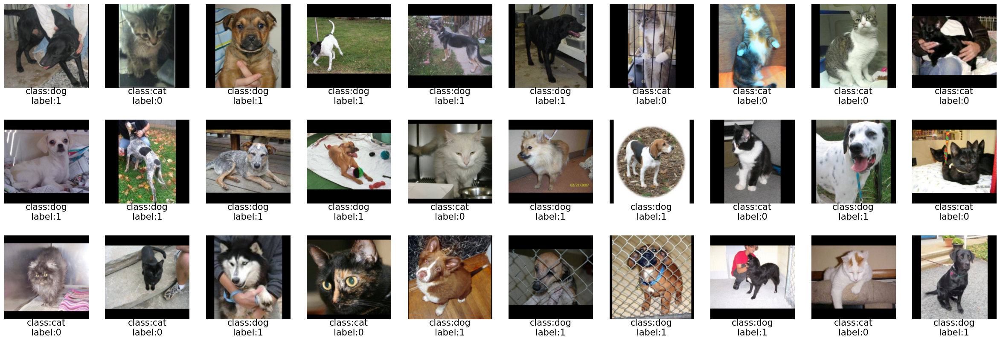

In [11]:
fig, ax = plt.subplots(3, 10, figsize = (30,10))  
ax = ax.ravel()  
classification_dict = {1: "dog", 0: "cat"}
for i in range(30): 
    
    image = transform_to_show_original(train_dataset[i][0])
    ax[i].imshow(image)
    ax[i].axis('off') 
    label = f"class:{classification_dict[train_dataset[i][1]]}\nlabel:{train_dataset[i][1]}"
    ax[i].text(
        0.5, -0.1, str(label), 
        fontsize=15, ha='center', va='center', transform=ax[i].transAxes )


The data indeed looks like cats and dogs! I also included the labels that pytorch's dataloader assigns to each class. In here, label value of 1 is assigned to dogs and label value of 0 is assigned to cats.

In [12]:
transform_to_image = torchvision.transforms.ToPILImage()

Now lets visualize the same 30 sample images from the training dataset along with their corresponding labels, this time after they are transformed to be a suitable input to our CNN. We can see how the mean and std of ImageNet's images affect the visuals of our images.  
This is one of the aspects of CNNs that is different from humans. It might be very hard for humans to distinguish the classes after they have been transformed as such, but CNNs are not only not affected, but they prefer it.   

By normalizing images using these values, we standardize the input to have similar statistical properties to the training data, which helps the pre-trained models perform optimally. 

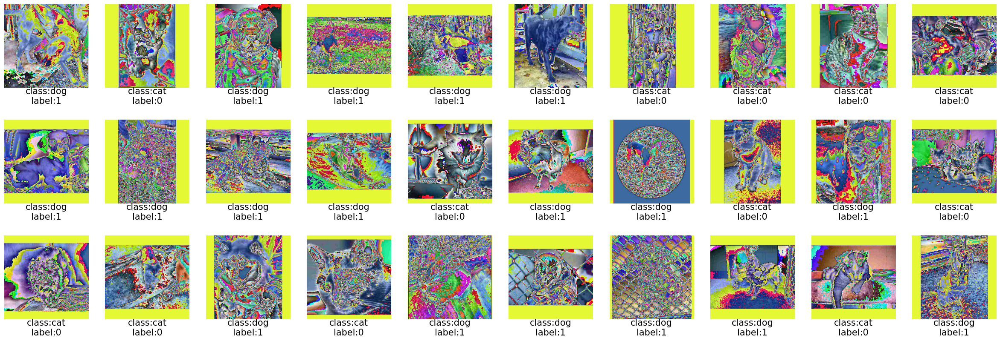

In [13]:
fig, ax = plt.subplots(3, 10, figsize = (30,10))  
ax = ax.ravel()  
classification_dict = {1: "dog", 0: "cat"}
for i in range(30): 
    
    image = transform_to_image(train_dataset[i][0])
    ax[i].imshow(image)
    ax[i].axis('off') 
    label = f"class:{classification_dict[train_dataset[i][1]]}\nlabel:{train_dataset[i][1]}"
    ax[i].text(
        0.5, -0.1, str(label), 
        fontsize=15, ha='center', va='center', transform=ax[i].transAxes )


This command outputs real-time information, such as GPU utilization, memory usage, processes running on the GPU, temperature, and power consumption.   

This is particularly helpful in deep learning tasks as it allows me to confirm whether a GPU is available, how much memory is free for model training, and whether other processes are consuming GPU resources.  
I can also leverage parallel processing and the use of multiple GPUs for speeding up the model training and testing processes.  

In [14]:
!nvidia-smi

Wed Dec 11 15:43:59 2024       
+-----------------------------------------------------------------------------------------+
| NVIDIA-SMI 550.127.05             Driver Version: 550.127.05     CUDA Version: 12.4     |
|-----------------------------------------+------------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id          Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |           Memory-Usage | GPU-Util  Compute M. |
|                                         |                        |               MIG M. |
|=========================================+========================+======================|
|   0  NVIDIA GeForce RTX 2080 Ti     Off |   00000000:1A:00.0 Off |                  N/A |
| 31%   42C    P8             19W /  250W |     805MiB /  11264MiB |      0%      Default |
|                                         |                        |                  N/A |
+-----------------------------------------+-----

We can see that we have access to 8 Nvidia 2080Tis, and this is very good for parallel training. This will make the training times very fast!

## 2) Model Training

In [15]:
dataloaders = {'train': train_loader, 'val': val_loader}
dataset_sizes = {'train': len(train_dataset), 'val': len(val_dataset)}
class_names = full_dataset.classes

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

model_ft = models.googlenet(weights=models.GoogLeNet_Weights.IMAGENET1K_V1)

num_ftrs = model_ft.fc.in_features
model_ft.fc = nn.Linear(num_ftrs, len(class_names))

if torch.cuda.device_count() > 1:
    print(f"Using {torch.cuda.device_count()} GPUs")
    model_ft = nn.DataParallel(model_ft)

model_ft = model_ft.to(device)

criterion = nn.CrossEntropyLoss()

optimizer_ft = optim.AdamW(model_ft.parameters(), lr=0.0001, weight_decay=1e-5)

num_epochs =50

Using 8 GPUs


I set up the GoogLeNet model for my project, starting by preparing the data loaders for both training and validation.   
For the model, I used a pre-trained GoogLeNet architecture with weights already trained on ImageNet (However, I will be training the whole architecture and all the wights).  

I modified the final layer to match the number of classes in my dataset so the model could classify images correctly. Since my system has multiple GPUs, I made sure the model could use all of them for faster training.   

I used crossentropy as the loss function to measure the performance during training, and I chose the AdamW optimizer with a learning rate of 0.0001 and a slight weight decay to keep the training stable and prevent overfitting.   
Finally, I set the number of training epochs to 50, giving the model enough time to adjust and perform well on the dataset.

Lets define a function to make the training process easier (I trained multiple CNNs, but ended up only using GoogleNet):

In [16]:
def train_model(model, criterion, optimizer, num_epochs=25):
    for epoch in range(num_epochs):
        
        torch.cuda.empty_cache()

        print(f'Epoch {epoch}/{num_epochs - 1}')
        print('---------------------')

        c = datetime.now()
        current_time = c.strftime('%H:%M:%S')
        print('Current Time is:', current_time)
        print('---------------------')

        for phase in ['train', 'val']:
            if phase == 'train':
                model.train()
            else:
                model.eval()

            running_loss = 0.0
            running_corrects = 0

            for inputs, labels in dataloaders[phase]:
                inputs = inputs.to(device)
                labels = labels.to(device)

                optimizer.zero_grad()
                with torch.set_grad_enabled(phase == 'train'):
                    outputs = model(inputs)
                    _, preds = torch.max(outputs, 1)
                    loss = criterion(outputs, labels)

                    if phase == 'train':
                        loss.backward()
                        optimizer.step()

                running_loss += loss.item() * inputs.size(0)
                running_corrects += torch.sum(preds == labels.data)

            epoch_loss = running_loss / dataset_sizes[phase]
            epoch_acc = running_corrects.double() / dataset_sizes[phase]

            print(f'{phase} Loss: {epoch_loss:.4f} Acc: {epoch_acc:.4f}')

    return model

And lets define the confusion matrix plotter. This will help us in visualizing the F-1 score, recall and accuracy of our model.

In [17]:
def plot_confusion_matrix(cm, class_names, save_path):
    plt.figure(figsize=(10, 8))
    sns.heatmap(cm, annot=True, fmt="d", cmap="Blues", xticklabels=class_names, yticklabels=class_names)
    plt.ylabel('True label')
    plt.xlabel('Predicted label')
    plt.title('Confusion Matrix')

    os.makedirs(os.path.dirname(save_path), exist_ok=True)  
    plt.savefig(save_path)
    plt.close()  


And, lets train the model:

In [ ]:
model_ft = train_model(model_ft, criterion, optimizer_ft, num_epochs=num_epochs)

models_dir = './models'
os.makedirs(models_dir, exist_ok=True)

model_save_path = os.path.join(models_dir, f"TransferModel_GoogleNet_{num_epochs}.pth")
torch.save(model_ft.state_dict(), model_save_path)

print(f"Model saved at: {model_save_path}")


'\nmodel_ft = train_model(model_ft, criterion, optimizer_ft, num_epochs=num_epochs)\n\nmodels_dir = \'./models\'\nos.makedirs(models_dir, exist_ok=True)\n\nmodel_save_path = os.path.join(models_dir, f"TransferModel_GoogleNet_{num_epochs}.pth")\ntorch.save(model_ft.state_dict(), model_save_path)\n\nprint(f"Model saved at: {model_save_path}")\n'

Next, I will evaluate the model that I have trained:

In [19]:
model_ft.eval()
all_preds = []
all_labels = []

with torch.no_grad():
    for inputs, labels in dataloaders['val']:
        inputs = inputs.to(device)
        labels = labels.to(device)

        outputs = model_ft(inputs)
        _, preds = torch.max(outputs, 1)

        all_preds.extend(preds.cpu().numpy())
        all_labels.extend(labels.cpu().numpy())

cm = confusion_matrix(all_labels, all_preds)
print('Confusion Matrix:')
print(cm)
print('\nClassification Report:')
print(classification_report(all_labels, all_preds, target_names=class_names))

reports_dir = './Reports'
os.makedirs(reports_dir, exist_ok=True)

report_path = os.path.join(reports_dir, f"classification_report_val_GoogleNet_{num_epochs}.txt")
with open(report_path, 'w') as f:
    f.write(classification_report(all_labels, all_preds, target_names=class_names))


confusion_path = os.path.join(reports_dir, f"confusion_matrix_val_GoogleNet_{num_epochs}.png")
plot_confusion_matrix(cm, class_names, confusion_path)

print(f"Classification report saved at: {report_path}")
print(f"Confusion matrix saved at: {confusion_path}")

Confusion Matrix:
[[827 198]
 [683 292]]

Classification Report:
              precision    recall  f1-score   support

        cats       0.55      0.81      0.65      1025
        dogs       0.60      0.30      0.40       975

    accuracy                           0.56      2000
   macro avg       0.57      0.55      0.53      2000
weighted avg       0.57      0.56      0.53      2000

Classification report saved at: ./Reports/classification_report_val_GoogleNet_50.txt
Confusion matrix saved at: ./Reports/confusion_matrix_val_GoogleNet_50.png


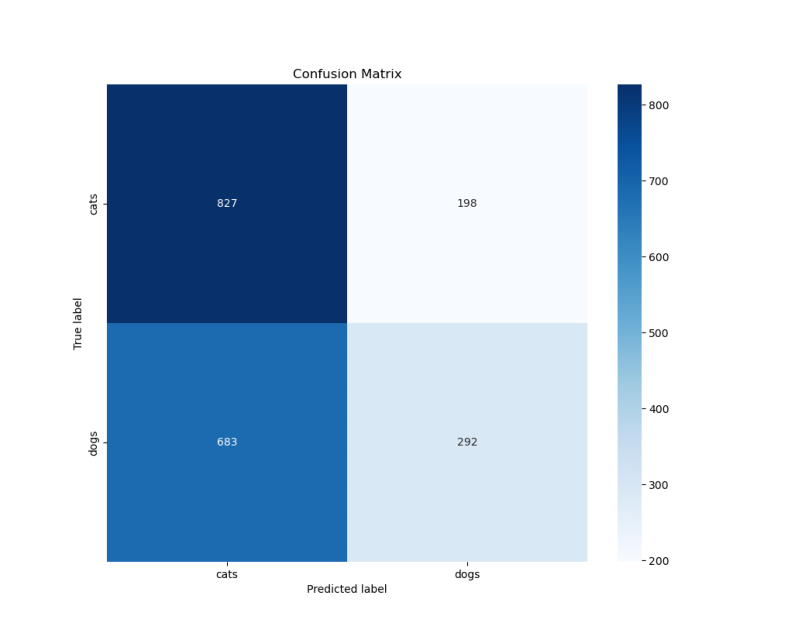

In [20]:
img = mpimg.imread('./Reports/confusion_matrix_val_GoogleNet_50.png')  
plt.figure(figsize=(10, 10)) 
plt.imshow(img)
plt.axis('off')  
plt.show()

After training the model, I evaluated its performance using a confusion matrix and a classification report to understand how well it distinguished between cats and dogs on the validation dataset.    
The confusion matrix shows the model correctly classified 827 cats and 292 dogs, but it misclassified 198 cats as dogs and 683 dogs as cats.   
The model achieved a precision of 55% for cats and 60% for dogs, meaning it was slightly better at identifying dogs correctly when it made a prediction. However, the recall for dogs was lower at 30%, indicating the model struggled to identify all dog images correctly, while the recall for cats was better at 81%.   
The overall accuracy of the model was 56%, and the weighted average F1-score was 53%. These metrics suggest that while the model shows some ability to differentiate between cats and dogs, there is room for improvement.  

However, since the validation data was small(2,000 images), lets wait and see what the testing phase shows us.

In [21]:
test_data_dir = f'./dog-cat-full-dataset-master/data/test'

Loading the test dataset for testing:

In [22]:
num_epochs = 50

test_dataset = datasets.ImageFolder(test_data_dir, transform=data_transforms)
test_loader = DataLoader(test_dataset, batch_size=4, shuffle=False, num_workers=16)


model = models.googlenet(weights=models.GoogLeNet_Weights.IMAGENET1K_V1)
num_ftrs = model.fc.in_features
model.fc = nn.Linear(num_ftrs, len(test_dataset.classes))

if torch.cuda.device_count() > 1:
    print(f"Using {torch.cuda.device_count()} GPUs")
    model = nn.DataParallel(model)

model = model.to(device)

model.load_state_dict(torch.load(f'./models/TransferModel_GoogleNet_{num_epochs}.pth'))

Using 8 GPUs


/tmp/ipykernel_2731464/1743156118.py:17: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load(f'./models/TransferModel_GoogleNet_{num_epochs}.pth')

<All keys matched successfully>

And evaluating the model:

In [ ]:
model.eval()

all_test_preds = []
all_test_labels = []

with torch.no_grad():
    for inputs, labels in test_loader:
        inputs = inputs.to(device)
        labels = labels.to(device)

        outputs = model(inputs)
        _, preds = torch.max(outputs, 1)

        all_test_preds.extend(preds.cpu().numpy())
        all_test_labels.extend(labels.cpu().numpy())

cm_test = confusion_matrix(all_test_labels, all_test_preds)
print('Test Confusion Matrix:')
print(cm_test)

print('\nTest Classification Report:')
print(classification_report(all_test_labels, all_test_preds, target_names=test_dataset.classes))

reports_dir = './Reports'
os.makedirs(reports_dir, exist_ok=True)


test_confusion_path = os.path.join(reports_dir, f"confusion_matrix_test_GoogleNet_{num_epochs}.png")
plot_confusion_matrix(cm_test, test_dataset.classes, test_confusion_path)

test_report_path = os.path.join(reports_dir, f"classification_report_test_GoogleNet_{num_epochs}.txt")
with open(test_report_path, 'w') as f:
    f.write(classification_report(all_test_labels, all_test_preds, target_names=test_dataset.classes))

print(f"Test Classification report saved at: {test_report_path}")
print(f"Test Confusion matrix saved at: {test_confusion_path}")


              precision    recall  f1-score   support

        cats       0.89      0.98      0.93      2500
        dogs       0.98      0.87      0.92      2500

    accuracy                           0.93      5000
   macro avg       0.93      0.93      0.93      5000
weighted avg       0.93      0.93      0.93      5000


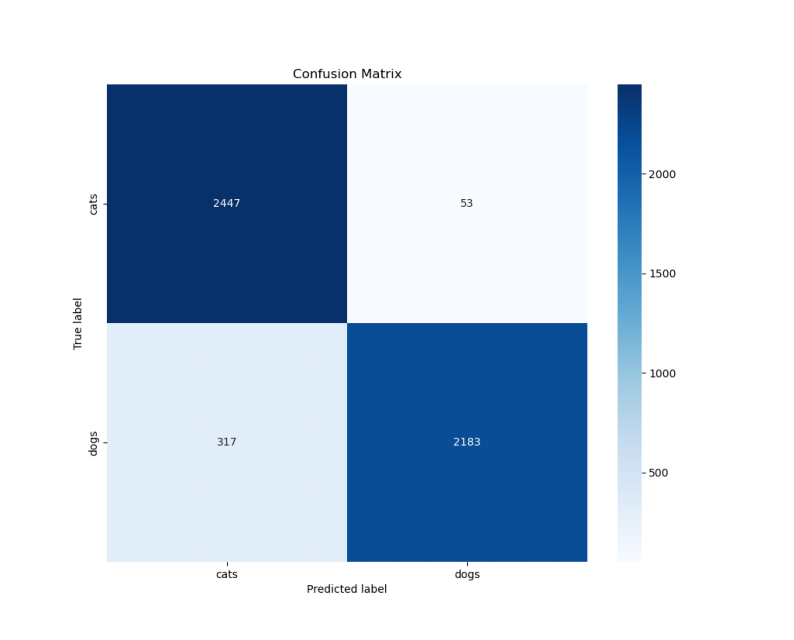

In [ ]:
img = mpimg.imread('./Reports/confusion_matrix_test_GoogleNet_50.png')  
plt.figure(figsize=(10, 10)) 
plt.imshow(img)
plt.axis('off')  
plt.show()

During the testing phase, the model demonstrated strong performance, achieving an overall accuracy of 93% on the test dataset of 5000 images.   
Breaking it down by class, the model achieved a precision of 89% for cats and 98% for dogs, showing it is highly confident in its predictions, specially for dogs. The recall for cats was excellent at 98%, showing that the model correctly identified nearly all cat images, while the recall for dogs was slightly lower at 87%, meaning a small number of dogs were misclassified.  

The F1-scores for both classes were high, at 93% for cats and 92% for dogs, reflecting a good balance between precision and recall. The macro and weighted averages across all metrics also confirm the model's reliability and consistency.  
 
These results suggest that the model effectively learned to classify cats and dogs, so no need to worry!

Now that we have a trained model, lets look at the structure of the model to better understand what modules and sections it is made up of:

In [ ]:
print(model)

DataParallel(
  (module): GoogLeNet(
    (conv1): BasicConv2d(
      (conv): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
      (bn): BatchNorm2d(64, eps=0.001, momentum=0.1, affine=True, track_running_stats=True)
    )
    (maxpool1): MaxPool2d(kernel_size=3, stride=2, padding=0, dilation=1, ceil_mode=True)
    (conv2): BasicConv2d(
      (conv): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn): BatchNorm2d(64, eps=0.001, momentum=0.1, affine=True, track_running_stats=True)
    )
    (conv3): BasicConv2d(
      (conv): Conv2d(64, 192, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn): BatchNorm2d(192, eps=0.001, momentum=0.1, affine=True, track_running_stats=True)
    )
    (maxpool2): MaxPool2d(kernel_size=3, stride=2, padding=0, dilation=1, ceil_mode=True)
    (inception3a): Inception(
      (branch1): BasicConv2d(
        (conv): Conv2d(192, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (bn

The printed architecture shows the customized GoogLeNet model used for our classification task.   
GoogLeNet's Inception modules enable multi-scale feature extraction through parallel convolution and pooling layers. 

The model includes initial convolutional layers, multiple Inception modules, global average pooling, dropout for regularization, and a final fully connected layer modified for binary classification. 


Lets use the torchinfo package to get a better understanding of the structure of the model and its different layers:

In [ ]:
summary(model)

Layer (type:depth-idx)                        Param #
DataParallel                                  --
├─GoogLeNet: 1-1                              --
│    └─BasicConv2d: 2-1                       --
│    │    └─Conv2d: 3-1                       9,408
│    │    └─BatchNorm2d: 3-2                  128
│    └─MaxPool2d: 2-2                         --
│    └─BasicConv2d: 2-3                       --
│    │    └─Conv2d: 3-3                       4,096
│    │    └─BatchNorm2d: 3-4                  128
│    └─BasicConv2d: 2-4                       --
│    │    └─Conv2d: 3-5                       110,592
│    │    └─BatchNorm2d: 3-6                  384
│    └─MaxPool2d: 2-5                         --
│    └─Inception: 2-6                         --
│    │    └─BasicConv2d: 3-7                  12,416
│    │    └─Sequential: 3-8                   129,472
│    │    └─Sequential: 3-9                   7,776
│    │    └─Sequential: 3-10                  6,208
│    └─Inception: 2-7              

This gives us a more structured and organized view on GoogleNet's architecture.

In [ ]:
for name, module in model.named_modules():
    if isinstance(module, torch.nn.Conv1d):
        print(f"{name}        {module}")

In [ ]:
for name, module in model.named_modules():
    if isinstance(module, torch.nn.Conv3d):
        print(f"{name}        {module}")

One thing that we can see is that GoogleNet has no Conv1d or Conv3d modules, only Conv2d layers.
Since we want to use the convolutional layers for feature map visualization, lets save all the 2D convolutional layers in a list so we can later use them.

In [ ]:
list_of_conv_layers = []
for name, module in model.named_modules():
    if isinstance(module, torch.nn.Conv2d):
        print(f"{name}\n{module}\n")
        list_of_conv_layers.append(name)

module.conv1.conv
Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)

module.conv2.conv
Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)

module.conv3.conv
Conv2d(64, 192, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)

module.inception3a.branch1.conv
Conv2d(192, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)

module.inception3a.branch2.0.conv
Conv2d(192, 96, kernel_size=(1, 1), stride=(1, 1), bias=False)

module.inception3a.branch2.1.conv
Conv2d(96, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)

module.inception3a.branch3.0.conv
Conv2d(192, 16, kernel_size=(1, 1), stride=(1, 1), bias=False)

module.inception3a.branch3.1.conv
Conv2d(16, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)

module.inception3a.branch4.1.conv
Conv2d(192, 32, kernel_size=(1, 1), stride=(1, 1), bias=False)

module.inception3b.branch1.conv
Conv2d(256, 128, kernel_size=(1, 1), stride=(1, 1), bias=False)

module.ince

In [ ]:
print(len(list_of_conv_layers))

57


## 3) Feature Map Implementation

Now, lets implement the feature map extraction. For now, lets use a sample dog image and visualize it.

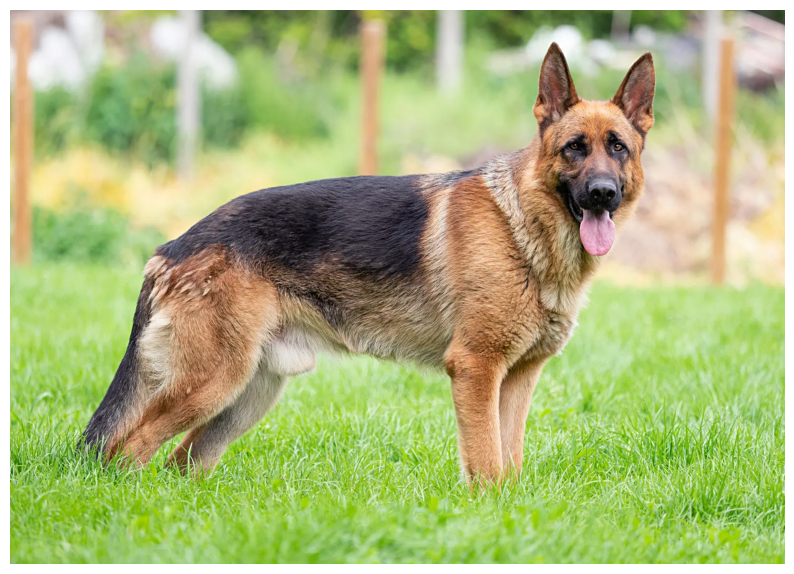

In [ ]:
img = mpimg.imread('./featuremap-data/dog1.jpg')  
plt.figure(figsize=(10, 10)) 
plt.imshow(img)
plt.axis('off')  
plt.show()

Lets double check the dimensions and shape of the sample dog image:

In [ ]:
image = Image.open("./featuremap-data/dog1.jpg") 
input_tensor = data_transforms(image).unsqueeze(0)
input_tensor.shape

torch.Size([1, 3, 224, 224])

This code will visualize the feature maps generated by different convolutional layers in our model (GoogleNet).   
By attaching a forward hook to each layer, I could capture its output when passing the input image through the model. For each layer, I extracted the feature map, normalized it to make it visually interpretable, and resized it to (224, 224) to match the input image dimensions. These feature maps are displayed in a grid, with each subplot showing how the layer processes and represents the input. 

This allows us to see what the model focuses on at different stages, from simple patterns like edges in early layers to more complex, abstract features in deeper layers. 

Hook triggered for Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
Captured feature map shape: torch.Size([1, 64, 112, 112])

Hook triggered for Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
Captured feature map shape: torch.Size([1, 64, 56, 56])

Hook triggered for Conv2d(64, 192, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
Captured feature map shape: torch.Size([1, 192, 56, 56])

Hook triggered for Conv2d(192, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
Captured feature map shape: torch.Size([1, 64, 28, 28])

Hook triggered for Conv2d(192, 96, kernel_size=(1, 1), stride=(1, 1), bias=False)
Captured feature map shape: torch.Size([1, 96, 28, 28])

Hook triggered for Conv2d(96, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
Captured feature map shape: torch.Size([1, 128, 28, 28])

Hook triggered for Conv2d(192, 16, kernel_size=(1, 1), stride=(1, 1), bias=False)
Captured feature map shape: torch.S

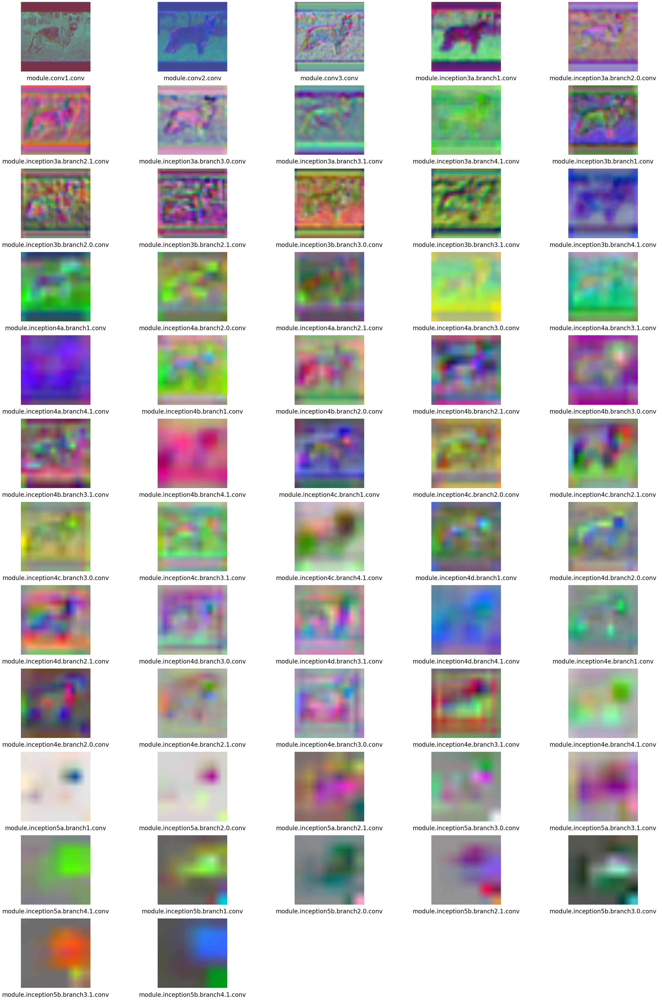

In [ ]:
fig, ax = plt.subplots(12, 5, figsize = (40,60))  
ax = ax.ravel()  
    
    
for i, layer_name in enumerate(list_of_conv_layers):
    feature_maps = {}


    def hook_fn(module, input, output):
        print(f"Hook triggered for {module}")
        feature_maps[layer_name] = output


    target_layer = dict(model.named_modules()).get(layer_name, None)

    hook_handle = target_layer.register_forward_hook(hook_fn)

    model.eval()


    with torch.no_grad():
        model(input_tensor)

    if layer_name in feature_maps:
        captured_output = feature_maps[layer_name]
        print(f"Captured feature map shape: {captured_output.shape}\n")
    else:
        print(f"No feature map captured for layer: {layer_name}\n")

    hook_handle.remove()

    tensor = captured_output[0]  
    tensor = tensor[:3, :, :]  
    tensor = (tensor - tensor.min()) / (tensor.max() - tensor.min())
    tensor = torch.nn.functional.interpolate(tensor.unsqueeze(0), size=(224, 224), mode='bilinear', align_corners=False).squeeze(0)  # Shape: [3, 224, 224]
    tensor = tensor.unsqueeze(0)  

    image = tensor[0].permute(1, 2, 0).detach().cpu().numpy()  
    
    ax[i].imshow(image)
    ax[i].axis('off') 
    label = layer_name
    ax[i].text(
        0.5, -0.1, str(label), 
        fontsize=20, ha='center', va='center', transform=ax[i].transAxes )
    
for j in range(len(list_of_conv_layers), len(ax)):
    ax[j].axis('off')
plt.show()


Moving from the top-left to the bottom-right, we observe how the representations of the input image evolve as it passes through the network, starting with the first convolutional layer and ending at the deepest layers.

#### Early Layers (Top Rows)

The first few rows represent the outputs from the initial convolutional layers. These layers focus on detecting basic low-level features such as edges, gradients, and simple textures. In these feature maps, we can still see a clear silhouette of the original input image, with contours and structures resembling the object in the image. The colors are a result of visualizing multiple channels combined as RGB, but they highlight basic visual patterns like sharp edges and contrasts.


#### Middle Layers (Middle Rows)

As we progress deeper into the network, the feature maps become more abstract. The original image structure starts to disappear, and instead, we see complex patterns emerging. These layers are responsible for detecting mid-level features such as shapes, corners, and textures. For example, the feature maps in these rows might highlight the structure of an ear, fur texture, or other intermediate details that help the network differentiate between classes (cats and dogs). The visualizations appear more scattered and colorful, indicating that the layers are combining various features learned from earlier layers.


#### Deeper Layers (Bottom Rows)

The feature maps in the deeper layers, shown in the last few rows, are the most abstract and specialized. By this point, the CNN has extracted high-level features relevant to classification. The visualizations in these layers are less recognizable, and any resemblance to the original input is almost entirely lost. Instead, these maps highlight patterns or regions of the input image that are most critical for making the classification decision. For instance, these layers might be focusing on specific combinations of features like ear shapes, fur patches, or color contrasts that are characteristic of cats or dogs. These deeper layers effectively summarize the image into compact representations that are specific to the target task.


#### How Feature Maps help us with explainability:

The feature maps illustrate how the network extracts information progressively, starting from basic patterns like edges and textures in the early layers, moving to structures and object parts in the middle layers, and finally focusing on high-level concepts in the deeper layers. 
By looking at these transformations, we can explain how the network combines low-level features into meaningful, class-specific representations, such as identifying fur patterns or ear shapes for cats and dogs.

By analyzing which parts of the input image activate certain feature maps, we can infer what features the network considers important:  

Early layers highlight edges and boundaries  ->  Network is focusing on basic shapes.  
Middle layers show a strong response to certain textures  ->  These textures are critical for classification.  
Deeper layers focus on specific regions, like the animal's head or body  ->  These areas of the image are most influential in the final decision.  


These visualizations can build trust by showing that the network bases its decisions on meaningful, human-interpretable features:

If deeper layers focus on recognizable parts of the image, such as the animal's head or ears, we can trust that the network is learning intuitive, human-aligned concepts.  
On the other hand, if the model makes decisions based on random or arbitrary patterns, it raises concerns about the model's reliability.  


Lets do the same process, but this time for a cat sample:

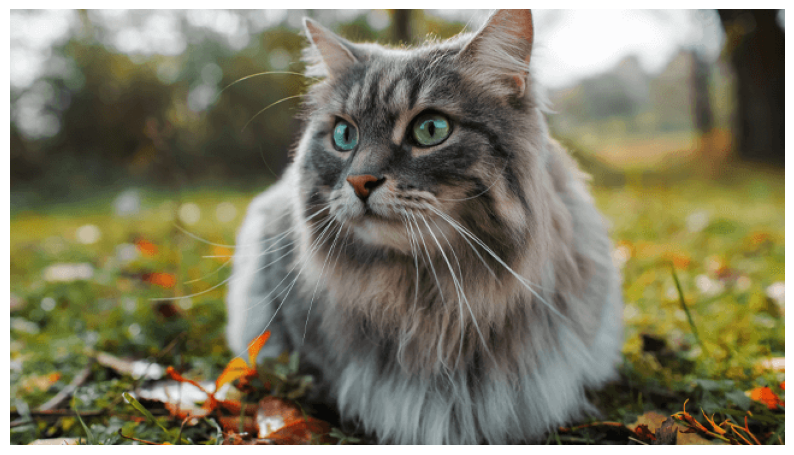

In [ ]:
img = mpimg.imread('./featuremap-data/cat1.jpg')  
plt.figure(figsize=(10, 10)) 
plt.imshow(img)
plt.axis('off')  
plt.show()

In [ ]:
image = Image.open("./featuremap-data/cat1.jpg")  

input_tensor = data_transforms(image).unsqueeze(0)
input_tensor.shape

torch.Size([1, 3, 224, 224])

Hook triggered for Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
Captured feature map shape: torch.Size([1, 64, 112, 112])

Hook triggered for Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
Captured feature map shape: torch.Size([1, 64, 56, 56])

Hook triggered for Conv2d(64, 192, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
Captured feature map shape: torch.Size([1, 192, 56, 56])

Hook triggered for Conv2d(192, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
Captured feature map shape: torch.Size([1, 64, 28, 28])

Hook triggered for Conv2d(192, 96, kernel_size=(1, 1), stride=(1, 1), bias=False)
Captured feature map shape: torch.Size([1, 96, 28, 28])

Hook triggered for Conv2d(96, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
Captured feature map shape: torch.Size([1, 128, 28, 28])

Hook triggered for Conv2d(192, 16, kernel_size=(1, 1), stride=(1, 1), bias=False)
Captured feature map shape: torch.S

Captured feature map shape: torch.Size([1, 128, 7, 7])

Hook triggered for Conv2d(832, 128, kernel_size=(1, 1), stride=(1, 1), bias=False)
Captured feature map shape: torch.Size([1, 128, 7, 7])



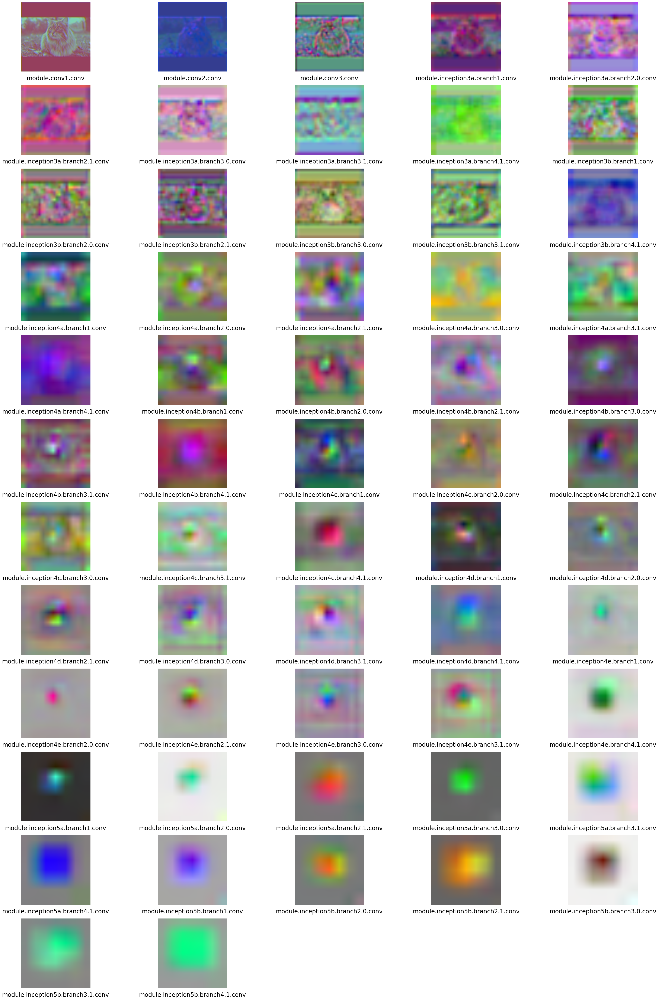

In [ ]:
fig, ax = plt.subplots(12, 5, figsize = (40,60))  
ax = ax.ravel()  
    
    
for i, layer_name in enumerate(list_of_conv_layers):
    feature_maps = {}


    def hook_fn(module, input, output):
        print(f"Hook triggered for {module}")
        feature_maps[layer_name] = output


    target_layer = dict(model.named_modules()).get(layer_name, None)

    hook_handle = target_layer.register_forward_hook(hook_fn)

    model.eval()


    with torch.no_grad():
        model(input_tensor)

    if layer_name in feature_maps:
        captured_output = feature_maps[layer_name]
        print(f"Captured feature map shape: {captured_output.shape}\n")
    else:
        print(f"No feature map captured for layer: {layer_name}\n")

    hook_handle.remove()

    tensor = captured_output[0]  
    tensor = tensor[:3, :, :]  
    tensor = (tensor - tensor.min()) / (tensor.max() - tensor.min())
    tensor = torch.nn.functional.interpolate(tensor.unsqueeze(0), size=(224, 224), mode='bilinear', align_corners=False).squeeze(0)  # Shape: [3, 224, 224]
    tensor = tensor.unsqueeze(0)  

    image = tensor[0].permute(1, 2, 0).detach().cpu().numpy()  
    
    ax[i].imshow(image)
    ax[i].axis('off') 
    label = layer_name
    ax[i].text(
        0.5, -0.1, str(label), 
        fontsize=20, ha='center', va='center', transform=ax[i].transAxes )
    
for j in range(len(list_of_conv_layers), len(ax)):
    ax[j].axis('off')
plt.show()


We can see the same patterns emerge for the cat sample image.   
The initial layers focus or more primitive features, like edges and contours, the middle layers focus on higher level features, like shape and textures, and finally, the final layers are specialized for the classification task and are very specialized and abstract. 

## 4) Saliency Map Implementation

This transformation pipeline prepares images specifically for generating saliency maps. 

In [ ]:
data_transforms_for_saliency = transforms.Compose([
    transforms.Resize(224),  
    SquarePad(),            
])

This function generates a saliency map to highlight which parts of the image are most important for the model's decision making.   
It works by processing the image through the model to get its prediction, then calculating how much each pixel of the input image influenced that prediction.  
 
The gradients of the predicted class score with respect to the input image are computed, and the absolute values of these gradients are used to represent importance.   
The strongest gradient values across color channels are selected to create a single-channel saliency map, which is then converted into a format that can be visualized.   

This map helps identify the areas in the image that the model focused on most for its classification.

In [ ]:
def compute_saliency_map(model, input_tensor):
    input_tensor.requires_grad_() 
    output = model(input_tensor)  
    pred_class = output.argmax(dim=1)  
    
    model.zero_grad()
    output[0, pred_class].backward()
    
    saliency = input_tensor.grad.data.abs()
    saliency, _ = saliency.max(dim=1) 
    return saliency.squeeze().cpu().numpy()


And this function plots the original image along with the saliency map calculated in the previous step.   
The juxtaposition of the original image and the saliency map will help us easily identify the regions of importance for the model's classification decision, and as a result, is a good way of explainability in CNNs.  

In [ ]:
def plot_saliency_map(original_image, saliency_map):
    original_image = data_transforms_for_saliency(original_image)
    fig, ax = plt.subplots(1, 2, figsize=(10, 10))
    
    ax[0].imshow(original_image)
    ax[0].axis('off')
    ax[0].set_title('Original Image')
    

    ax[1].imshow(saliency_map, cmap='hot')
    ax[1].axis('off')
    ax[1].set_title('Saliency Map')
    
    plt.tight_layout()
    plt.show()

In here, I will test our saliency function on our sample images of the last step. We can then compare the saliency maps with the feature maps, and see what similarities and differences these two explainability methods have.  

/s/babbage/b/nobackup/nblancha/merry/conda/envs/ERFAN-ENV/lib/python3.8/site-packages/torch/nn/parallel/_functions.py:75: FutureWarning: Using -1 to represent CPU tensor is deprecated. Please use a device object or string instead, e.g., "cpu".
  return comm.gather(inputs, ctx.dim, ctx.target_device)


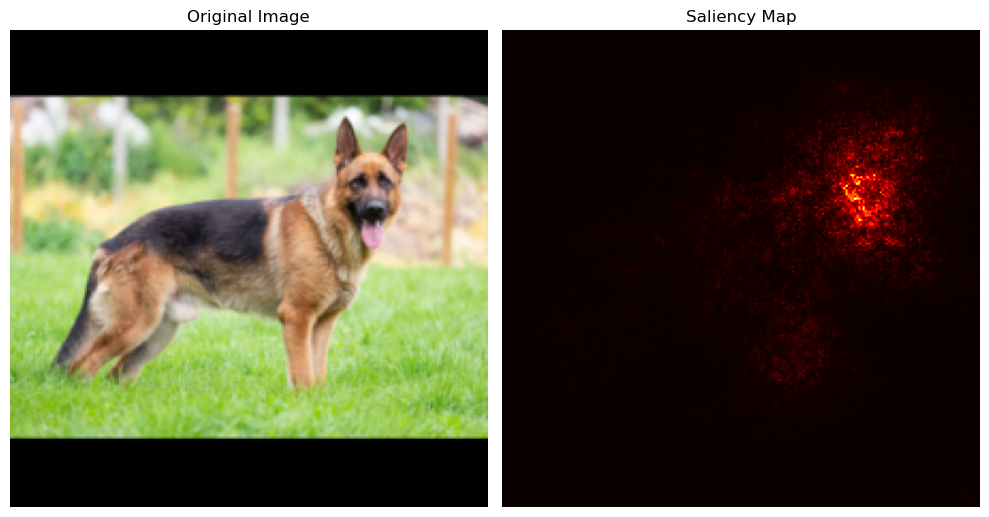

In [ ]:
image = Image.open("./featuremap-data/dog1.jpg") 
input_tensor = data_transforms(image).unsqueeze(0)

model.eval()

saliency_map = compute_saliency_map(model, input_tensor)
plot_saliency_map(image, saliency_map)

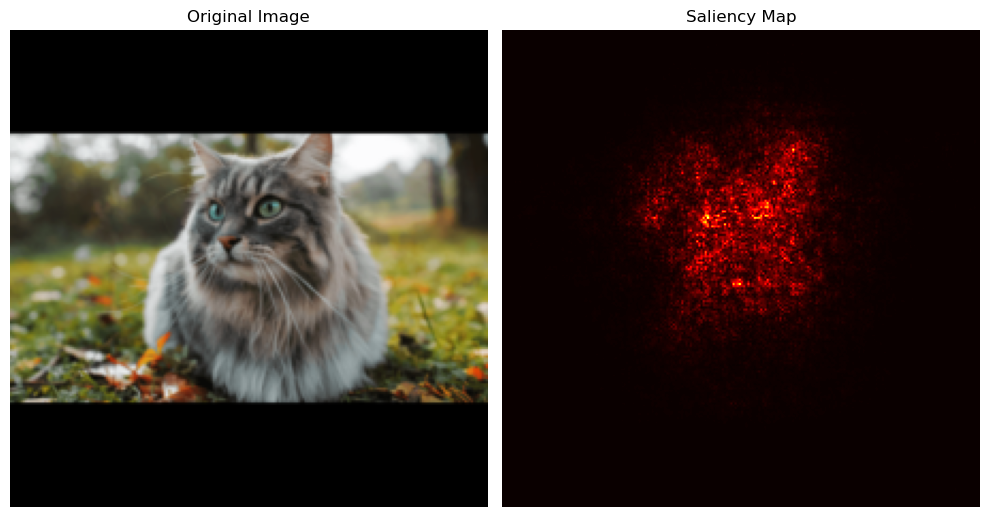

In [ ]:
image = Image.open("./featuremap-data/cat1.jpg") 
input_tensor = data_transforms(image).unsqueeze(0)

model.eval()

saliency_map = compute_saliency_map(model, input_tensor)
plot_saliency_map(image, saliency_map)

**For the Dog Image:** The model focuses intensely on the region around the dog's head and shoulders. This suggests that the network considers features in these areas such as the shape of the head, ears, or facial structure—critical for classifying the image.   

**For the Cat Image:** The model highlights areas near the cat's head and fur texture. It shows that the network pays attention to features like the fur's texture and the head's shape, which are important in distinguishing the image as a cat.  

#### Comparing Feature Maps and Saliency Maps:

Now that we have plotted both the feature maps and saliency maps for the same sample cat and dog images, lets take a step back and compare their similarities and differences:
##### Similarities

1) These techniques both visualize internal behavior. 

2) They both help identify important regions or features that influence the model's decisions, whether at an intermediate (feature map) or final (saliency map) stage.


##### Differences

1) Feature maps are layer-specific and show how the model processes information step by step, but saliency maps show the overall importance of regions in the input image for the final prediction.

2) Feature maps are more abstract in deeper layers, losing their connection to the original input, whereas saliency maps maintain a close relationship with the input image.


In short, saliency maps provide a more **focused view** of the model’s reasoning for a specific image, while feature maps give a **comprehensive understanding** of how the network processes data across **all layers**.

Now, lets visualize the saliency maps for more samples. In here, I will plot the saliency maps of 5 cat sample images and 5 dog sample images:

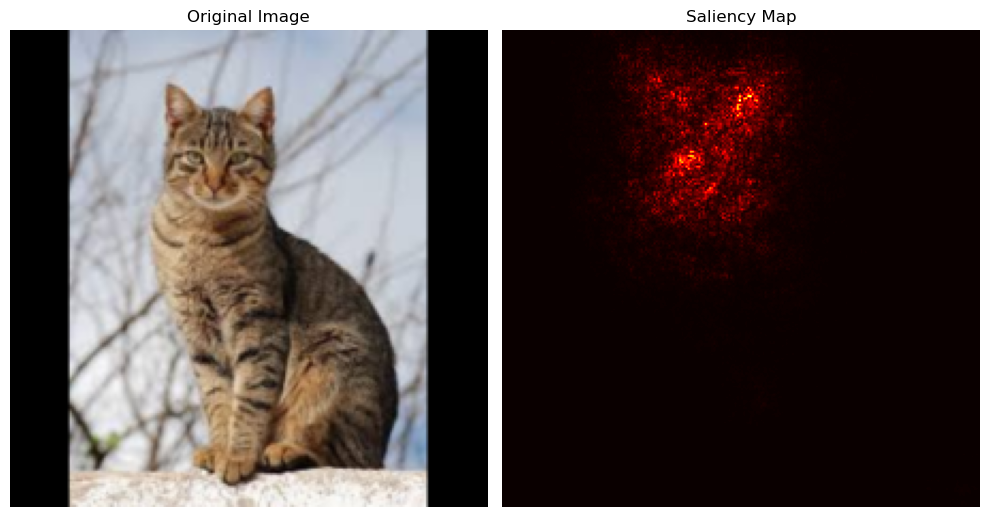

                                  Predicted class: cat, Probability: 1.0000




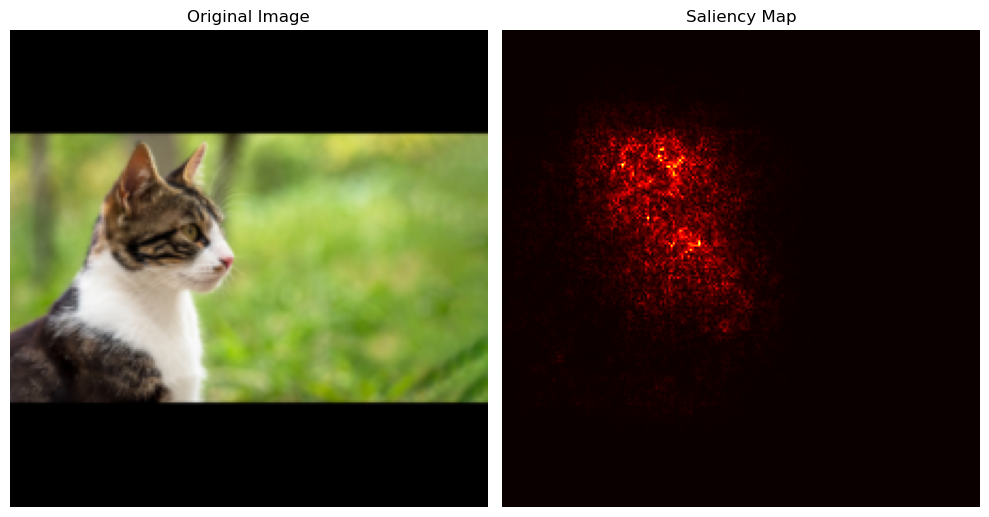

                                  Predicted class: cat, Probability: 1.0000




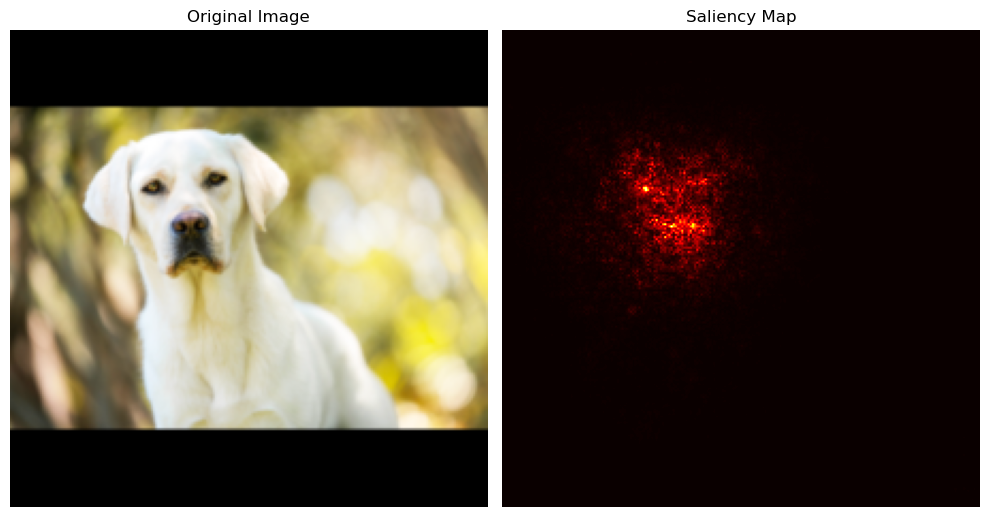

                                  Predicted class: dog, Probability: 1.0000




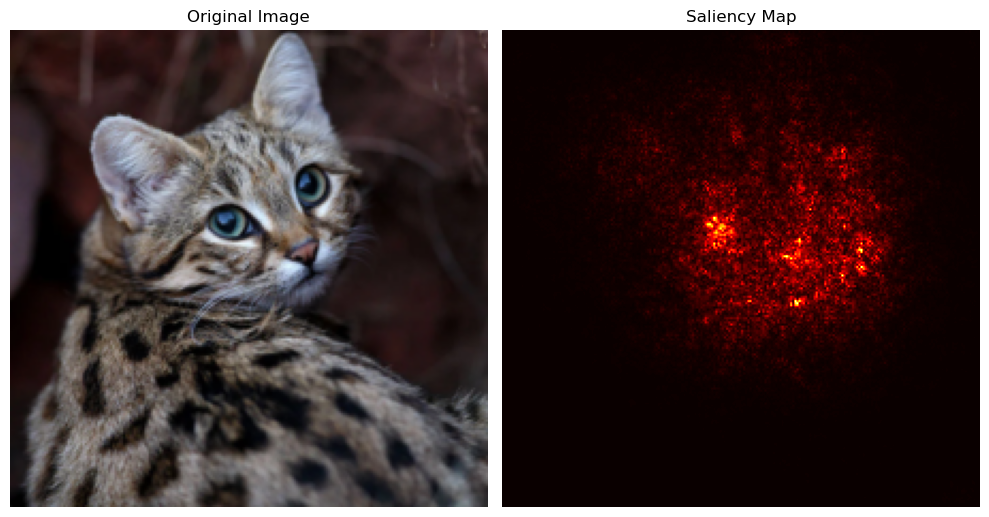

                                  Predicted class: cat, Probability: 1.0000




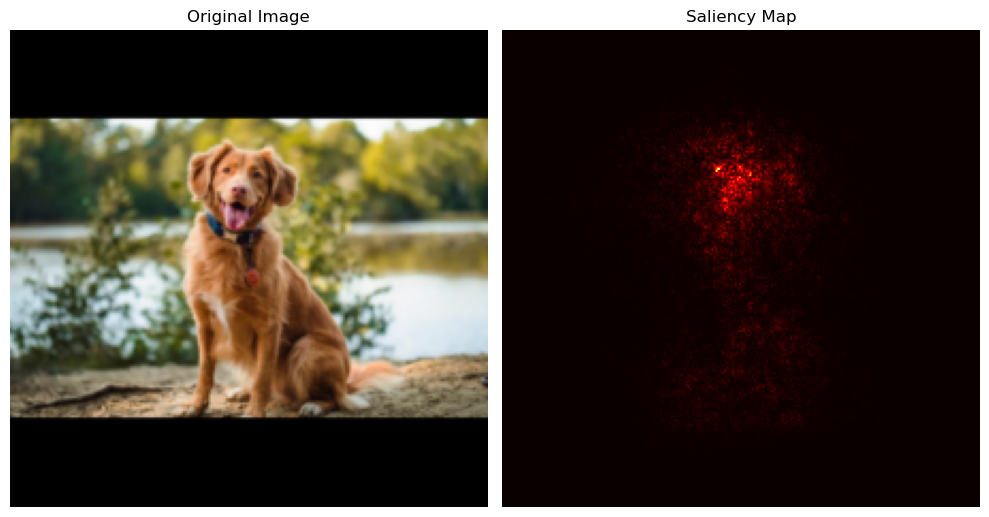

                                  Predicted class: dog, Probability: 1.0000




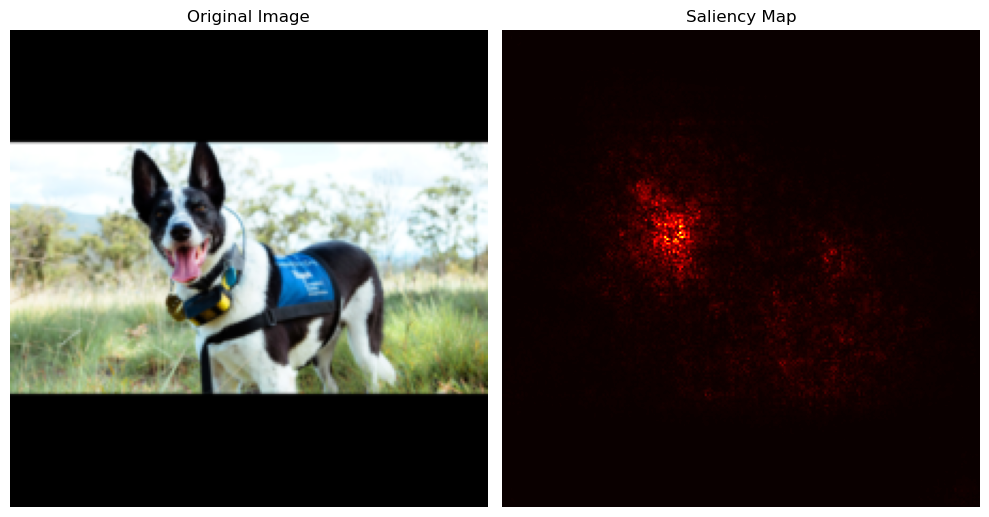

                                  Predicted class: dog, Probability: 0.9391




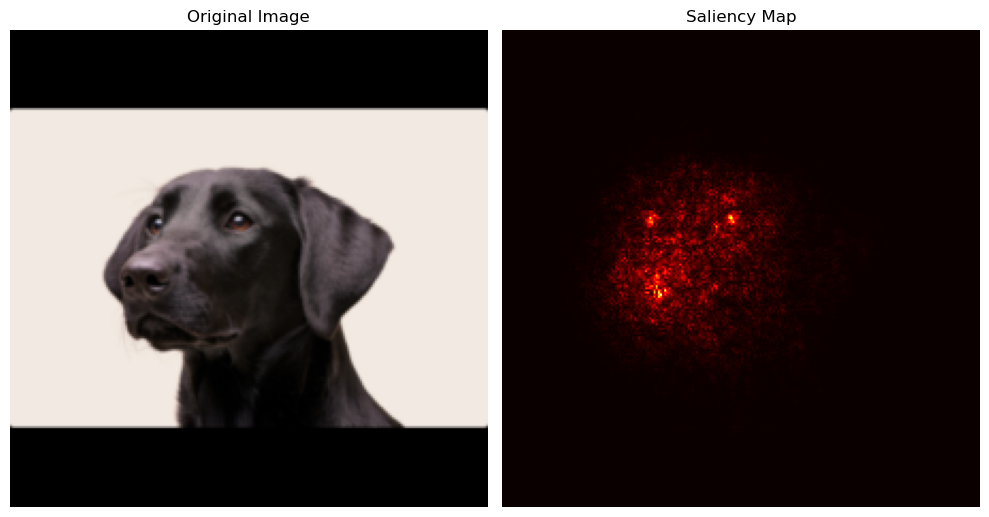

                                  Predicted class: dog, Probability: 1.0000




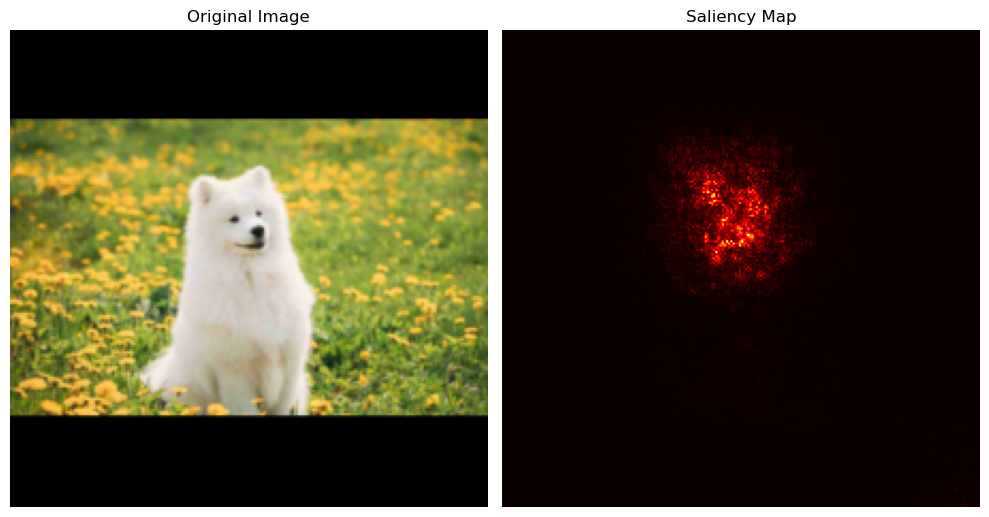

                                  Predicted class: dog, Probability: 0.5262




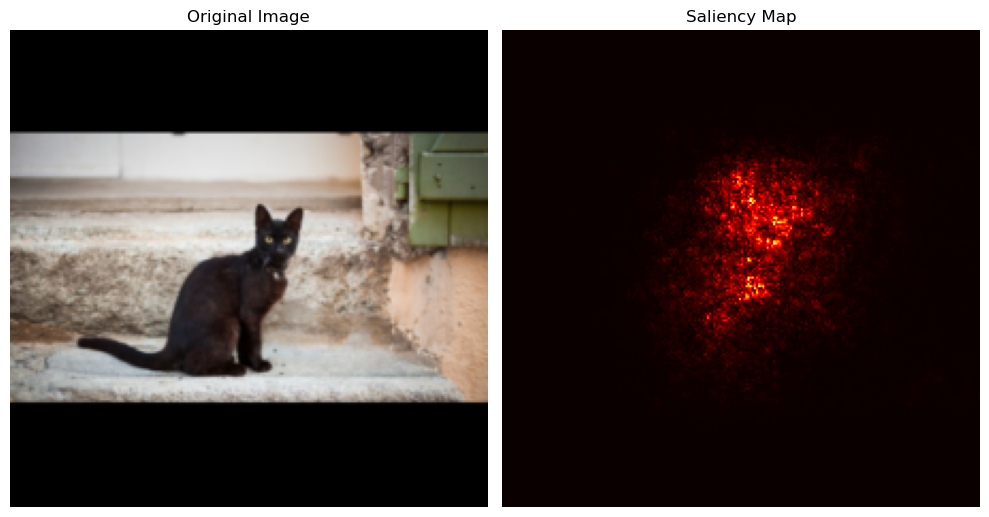

                                  Predicted class: cat, Probability: 1.0000




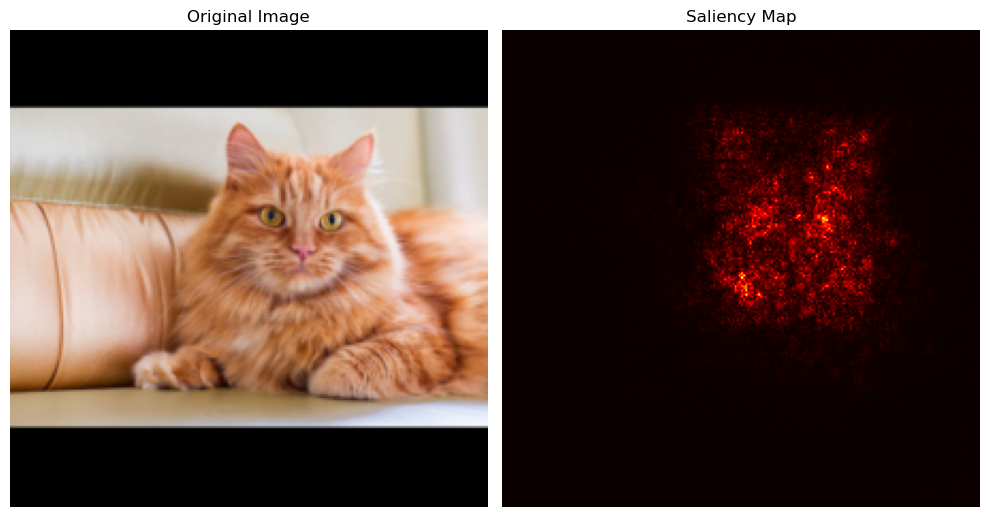

                                  Predicted class: cat, Probability: 1.0000




In [ ]:
import warnings
warnings.filterwarnings("ignore")


model.eval()

for file in os.listdir("./saliency-data/dataset/"):
    

    filename = os.fsdecode(file)
    if filename.endswith(".jpg"): 
        path_of_image = (os.path.join("./saliency-data/dataset/", filename))

        image = Image.open(path_of_image).convert("RGB")
         
        output = model(data_transforms(image).unsqueeze(0))
        
        
        probabilities = torch.nn.functional.softmax(output, dim=1)  
        predicted_class_index = probabilities.argmax(dim=1).item()  
        predicted_label = classification_dict[predicted_class_index]  

        input_tensor = data_transforms(image).unsqueeze(0)


        saliency_map = compute_saliency_map(model, input_tensor)
        plot_saliency_map(image, saliency_map)
        
        print(f"                                  Predicted class: {predicted_label}, Probability: {probabilities[0, predicted_class_index]:.4f}\n\n")



We can see that in all images of both classes, the model mainly focuses on the head area. This region includes the eyes, ears, nose, shape of the face and jaw.
 
Now, lets see how saliency maps work for images that are neither cat nor dog! Lets see how the learned features transfer to other unknown classes.  
Does the model still look for the head, ears and eyes? Or will it get lost and confused? 


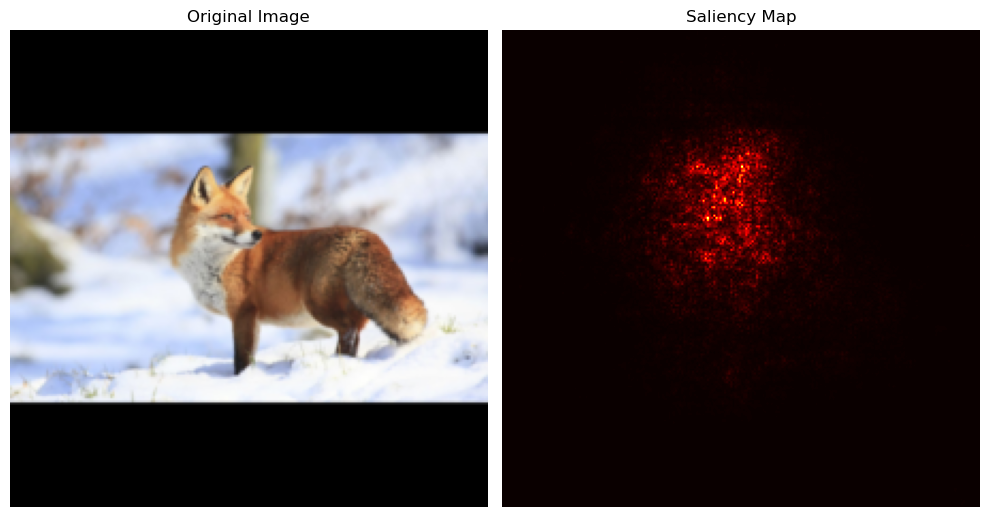

                                  Predicted class: cat, Probability: 0.8612




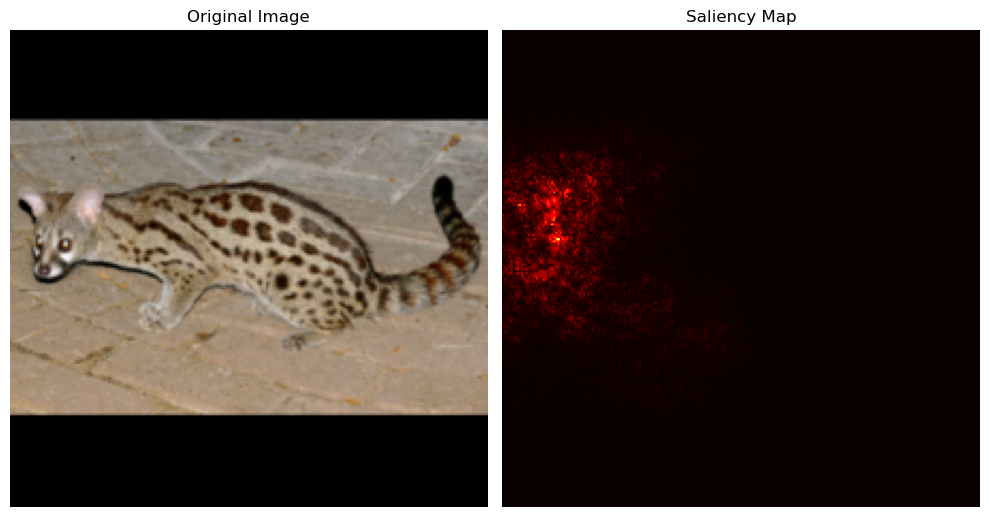

                                  Predicted class: cat, Probability: 0.9998




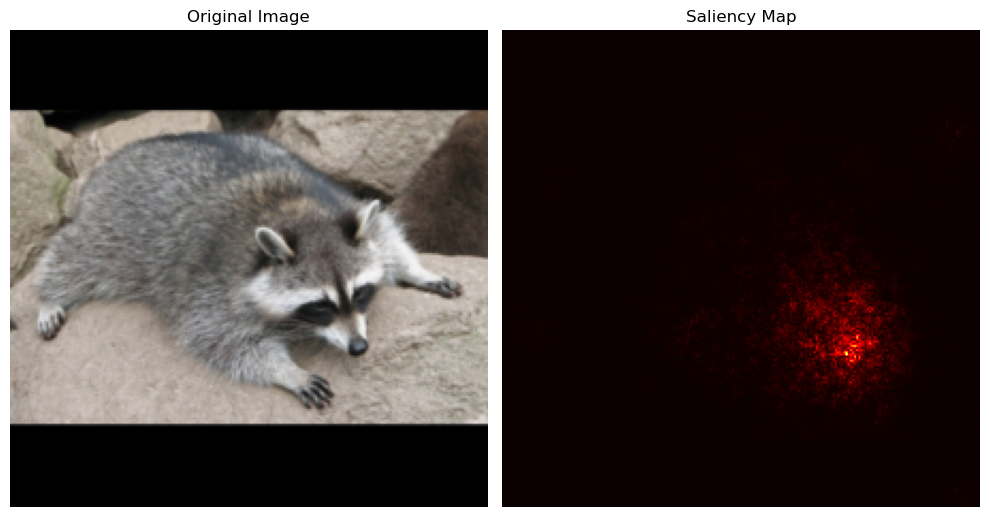

                                  Predicted class: dog, Probability: 0.6245




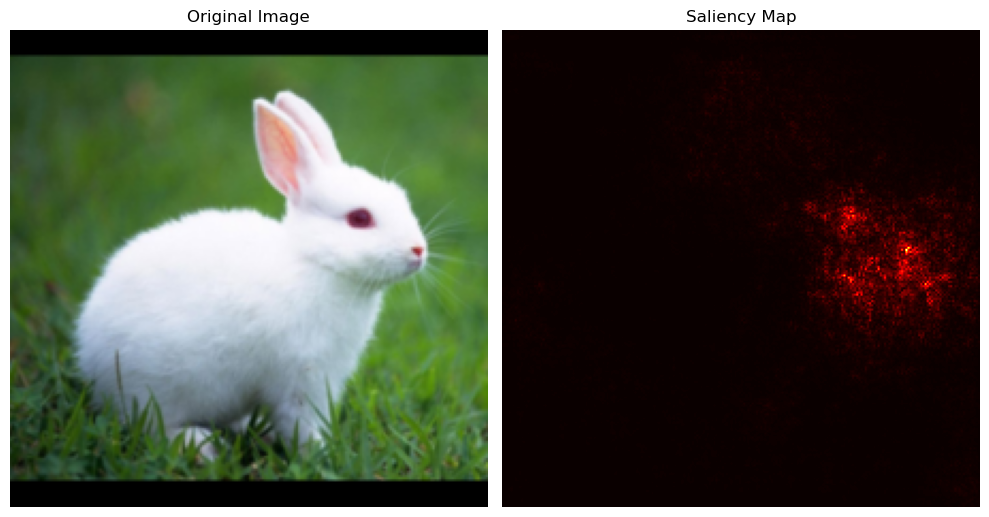

                                  Predicted class: cat, Probability: 0.5367




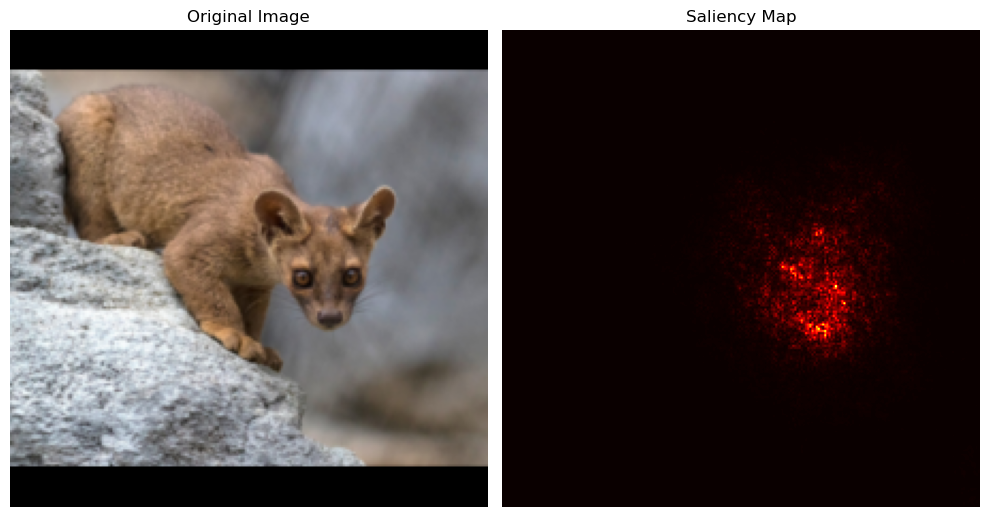

                                  Predicted class: dog, Probability: 1.0000




In [ ]:
model.eval()

for file in os.listdir("./saliency-data/unknown/"):
    

    filename = os.fsdecode(file)
    if filename.endswith(".jpg"): 
        path_of_image = (os.path.join("./saliency-data/unknown/", filename))

        image = Image.open(path_of_image).convert("RGB")
         
        output = model(data_transforms(image).unsqueeze(0))
        
        
        probabilities = torch.nn.functional.softmax(output, dim=1)  
        predicted_class_index = probabilities.argmax(dim=1).item()  
        predicted_label = classification_dict[predicted_class_index]  

        input_tensor = data_transforms(image).unsqueeze(0)


        saliency_map = compute_saliency_map(model, input_tensor)
        plot_saliency_map(image, saliency_map)
        
        print(f"                                  Predicted class: {predicted_label}, Probability: {probabilities[0, predicted_class_index]:.4f}\n\n")




In above, I have passed 5 images to the model that it has not seen before. These are fossa, rabbit, fox, raccoon and a genet. I specifically chose these animals because they look similar to dogs or cats, some of them look like both!  
It is also interesting to look at the class that the model assigns to each animal. Lets analyze the classification probabilities in detail:  


**Fox:** The model classifies the fox as a "cat" with a moderate confidence of 0.8612. The saliency map shows that the model focuses on the head region, especially the ears and face, likely because these features resemble those of a cat. However, the body of the fox, which could provide additional cues, appears less significant in the saliency map.

**Genet:** This is also classified as a "cat," with very high confidence (0.9998). The saliency map shows that the model pays attention to the overall body shape and texture, likely mistaking the genet's slim body and spotted fur for a domestic cat. Its tail and pattern may align closely with features learned from cat images.

**Raccoon:** Surprisingly, the model predicts "dog" for the raccoon, with moderate confidence (0.6245). The saliency map highlights the raccoon's face and fur texture. This might be because the rounded face and body proportions are closer to dogs in the model's learned features. However, the moderate confidence indicates some uncertainty in the prediction.

**Rabbit:** The rabbit is classified as a "cat" with lower confidence (0.5367). The saliency map highlights the rabbit's head and ears. The focus on the ears is interesting, as long ears may have confused the model into associating the rabbit with certain dog breeds that have distinctive ear shapes. The soft fur texture may also contribute to this confusion.

**Fossa:** The fossa is classified as a "dog" with a confidence of 1! The saliency map indicates that the model focuses on the head and body, likely mistaking its slim frame, fur, and facial structure for a cat. Also, the 100% confidence shows the model's certainty about this classification.


The predictions can be explained based on the visual features highlighted in the saliency maps, however, it also shows the need for diverse datasets and potentially more granular classifications when dealing with visually very similar species. These cases also show the model's reliance on specific features.


## 5) TCAV Implementation

Finally, lets implement TCAV to explore and find ways to explain the decision making processes of CNNs.

I implement this class to extract and save activations (feature maps) from a specific layer of a CNN for an entire dataset.   

The activations show what the model focuses on at that layer when processing input data, which is important for TCAV.  

The ActivationGenerator hooks into the target layer of the model using a forward hook, capturing the output (activations) during the forward pass.   
For each input in the dataset, it stores these activations, which are essentially summaries of the input image as processed by that layer. 

Then the get_activations method goes through the entire dataset, collects these activations, and combines them into one large array.



In [ ]:
class ActivationGenerator:
    def __init__(self, model, target_layer, device='cuda'):
        self.model = model
        self.target_layer = target_layer
        self.device = device
        self.activations = {}
        self.hook_handle = None

    def hook_layer(self):
        def get_activation(name):
            def hook(model, input, output):
                self.activations[name] = output.detach()
            return hook
        
        layer = dict([*self.model.named_modules()])[self.target_layer]
        layer.register_forward_hook(get_activation(self.target_layer))

        self.hook_handle = layer.register_forward_hook(get_activation(self.target_layer))

    def get_activations(self, dataset_loader):

        self.model.eval()
        self.hook_layer()
        
        # a list of activation of each input data, so in the end it will be an array of size: dataset_size * layer_dimensions 
        all_activations = []
        with torch.no_grad():
            for inputs, _ in dataset_loader:
                inputs = inputs.to(self.device)
                _ = self.model(inputs)
                all_activations.append(self.activations[self.target_layer].cpu().numpy())
                
        self.hook_handle.remove()

        print(np.concatenate(all_activations, axis=0).shape)
        return np.concatenate(all_activations, axis=0)

    def save_activations(self, activations, save_path):
        np.save(save_path, activations)
        print(f"Activations saved to {save_path}")
        print("\n")


The CAV class creates Concept Activation Vectors by analyzing the activations of a model’s layer for positive and negative concept examples.

It flattens and scales the activations, then uses a linear classifier to separate the two groups, producing a vector (CAV) that represents the concept. The trained CAV, intercept, and scaler will be saved, so we can measure the model's sensitivity to the concept.

In [ ]:
class CAV:
    def __init__(self, positive_concept_activations, negative_concept_activations, model_layer, concept_name, save_path):
        self.positive_concept_activations = positive_concept_activations
        self.negative_concept_activations = negative_concept_activations
        self.concept_name = concept_name
        self.model_layer = model_layer
        self.save_path = save_path
        self.cav = None
        self.intercept = None
        self.scaler = StandardScaler()

    def flatten_activations(self, activations):
        # flatten activations from (batch_size, channels, height, width) to (batch_size, channels*height*width)
        return activations.reshape(activations.shape[0], -1)
    
    def train_cav(self):
        positive_flat = self.flatten_activations(self.positive_concept_activations)
        negative_flat = self.flatten_activations(self.negative_concept_activations)

        X = np.concatenate([positive_flat, negative_flat], axis=0)
        y = np.concatenate([np.ones(len(positive_flat)), -np.ones(len(negative_flat))], axis=0)

        X = self.scaler.fit_transform(X)

        # train
        
        classifier = LinearSVC(max_iter=10000)
        #classifier = LogisticRegression(max_iter=100000, solver='saga')
        classifier.fit(X, y)
        
        self.cav = classifier.coef_
        self.intercept = classifier.intercept_
        
        self.save_cav()

    def save_cav(self):
        os.makedirs(self.save_path, exist_ok=True)
        np.save(os.path.join(self.save_path, f"CAV_{self.concept_name}_{self.model_layer}.npy"), self.cav)
        np.save(os.path.join(self.save_path, f"Intercept_{self.concept_name}_{self.model_layer}.npy"), self.intercept)
        joblib.dump(self.scaler, os.path.join(self.save_path, f"Scaler_{self.concept_name}_{self.model_layer}.joblib"))


Finally the TCAV class computes how sensitive a model's predictions are to a specific human-interpretable concept. 

It uses pretrained Concept Activation Vectors (CAVs) and the gradients of the model's outputs with respect to a target layer. 
The directional derivatives between gradients and CAVs measure concept importance, and the TCAV score is the fraction of positive directional derivatives. 

This score quantifies the influence of the concept on the model's predictions.

In [ ]:
class TCAV:
    def __init__(self, model, cav_path, concept_name, model_layer, test_loader, target_layer, target_class, device='cuda'):

        self.model = model
        self.test_loader = test_loader
        self.target_layer = target_layer
        self.target_class = target_class
        self.device = device
        self.activations = {}
        self.activations_grad = {}


        cav_file = os.path.join(cav_path, f"CAV_{concept_name}_{model_layer}.npy")
        intercept_file = os.path.join(cav_path, f"Intercept_{concept_name}_{model_layer}.npy")
        scaler_file = os.path.join(cav_path, f"Scaler_{concept_name}_{model_layer}.joblib")  # Note the .joblib extension

        self.cav = np.load(cav_file)
        self.intercept = np.load(intercept_file)
        self.scaler = joblib.load(scaler_file)

    def hook_layer(self):

        def forward_hook(module, input, output):
            self.activations[self.target_layer] = output
            if not output.requires_grad:
                output.requires_grad_(True)
            output.retain_grad()

        layer = dict([*self.model.named_modules()])[self.target_layer]
        layer.register_forward_hook(forward_hook)

    def get_activations_and_gradients(self, inputs):

        self.model.eval()
        self.hook_layer()
        self.model.zero_grad()

        inputs = inputs.to(self.device)
        outputs = self.model(inputs)

        # logit for the target class
        logits = outputs[:, self.target_class]
        score = logits.sum()

        # backward pass for gradients
        score.backward()

        activations = self.activations[self.target_layer].detach()
        gradients = self.activations[self.target_layer].grad.detach()

        activations = activations.cpu().numpy()
        gradients = gradients.cpu().numpy()

        activations_flat = activations.reshape(activations.shape[0], -1)
        gradients_flat = gradients.reshape(gradients.shape[0], -1)

        return activations_flat, gradients_flat

    def compute_tcav_score(self):

        all_directional_derivatives = []

        cav_flat = self.cav.flatten()

        for inputs, _ in self.test_loader:
            _, gradients = self.get_activations_and_gradients(inputs)

            gradients_scaled = self.scaler.transform(gradients)

            # directional derivative 
            directional_derivative = np.dot(gradients_scaled, cav_flat)
            all_directional_derivatives.extend(directional_derivative)

        all_directional_derivatives = np.array(all_directional_derivatives)

        tcav_score = np.mean(all_directional_derivatives > 0)
        return tcav_score


Now, I will define two concepts: 

1) Round eyes
2) Floppy ears

I want to see how influential these concepts are for the decision making process. I have gathered a dataset of 50 images of animals with round eyes as positive examples, and 50 images of animals with non-round eyes as negative examples.  
I did the save for the floppy ears concept.

Then, using the activation generator, CAV and TCAV classes that I defined above, I calculate the TCAV score for each concept for the las 5 convolutional layers of the GoogleNet CNN.  

In the following I plot some example of positive and negative examples of each concept:  

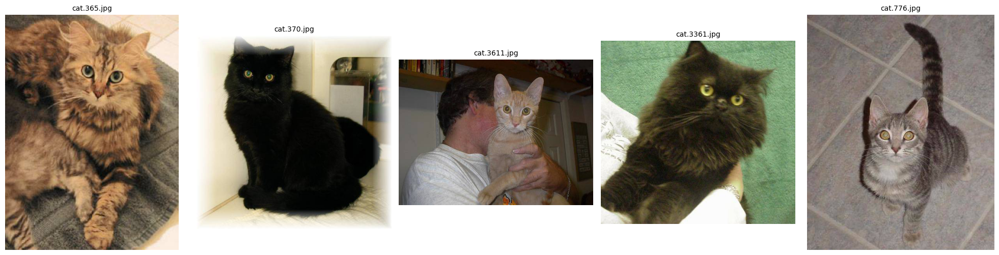

In [ ]:
import os
from PIL import Image
import matplotlib.pyplot as plt

def plot_images_from_directory(directory_path):
    image_files = [f for f in os.listdir(directory_path) if f.endswith(('jpg', 'jpeg', 'png'))][:5]
    
    fig, ax = plt.subplots(1, 5, figsize=(20, 5))
    
    for i, image_file in enumerate(image_files):
        img_path = os.path.join(directory_path, image_file)
        image = Image.open(img_path)
        
        ax[i].imshow(image)
        ax[i].axis('off')
        ax[i].set_title(image_file, fontsize=10)
    
    plt.tight_layout()
    plt.show()


plot_images_from_directory('./Concepts/PositiveConcepts/PositiveRoundEyes')


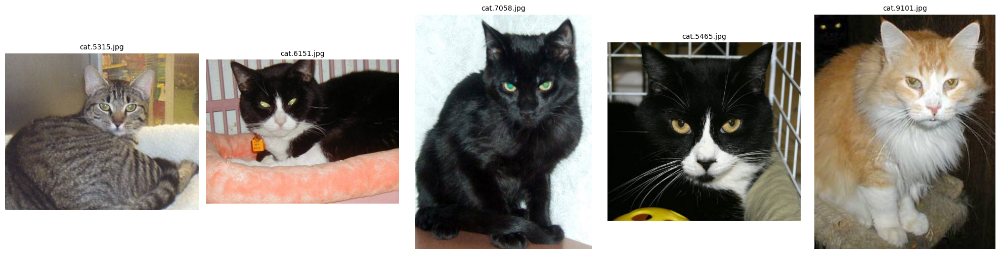

In [ ]:
plot_images_from_directory('./Concepts/NegativeConcepts/NegativeRoundEyes')

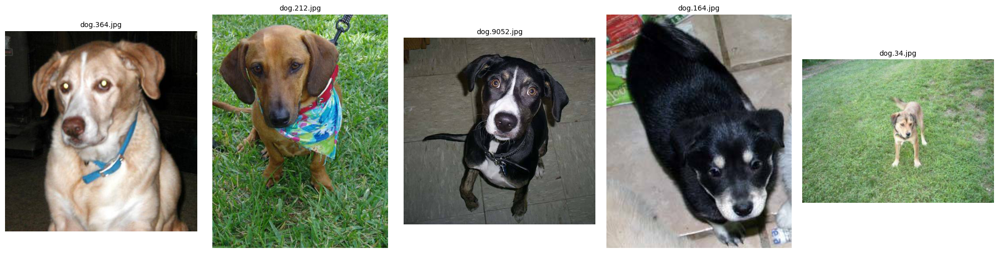

In [34]:
plot_images_from_directory('./Concepts/PositiveConcepts/PositiveFloppyEars')

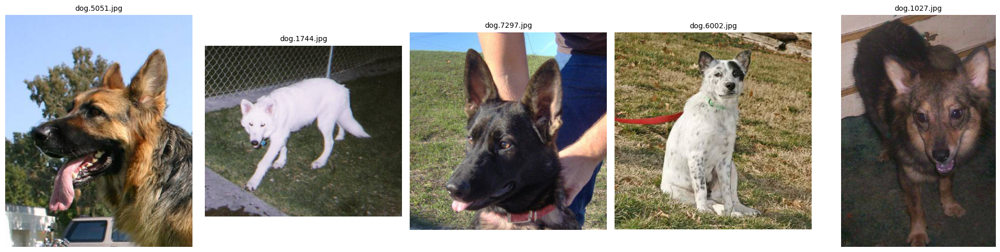

In [36]:
plot_images_from_directory('./Concepts/NegativeConcepts/NegativeFloppyEars')

### Note: Since calculating TCAV scores takes a very long time, I ran the code and copied the outputs as a markdown cell so I dont have to run them every time I restart my kernel. However, the outputs will be the same if you run the cell yourself.

In [ ]:
os.makedirs('./activations', exist_ok=True)
os.makedirs('./cavs', exist_ok=True)


concepts = ["RoundEyes", "FloppyEars"]


class SingleClassDataset(Dataset):
    def __init__(self, root_dir, transform=None):
        self.root_dir = root_dir
        self.transform = transform
        self.image_files = [f for f in os.listdir(root_dir) if f.endswith(('jpg', 'jpeg', 'png'))]

    def __len__(self):
        return len(self.image_files)

    def __getitem__(self, idx):
        img_path = os.path.join(self.root_dir, self.image_files[idx])
        image = Image.open(img_path).convert("RGB")
        
        if self.transform:
            image = self.transform(image)
        
        return image, 0



model = model.to(device)


# each directory containing the directories of xoncepts is called xoncepts_directory
# each directory that has either the positive or negative examples of a concept is called a xoncept

# for example, NegativeRoundEyes and PositiveRoundEyes are both xoncept
# for example, NegativeConcepts and PositiveConcepts are both xoncepts_directory


def xoncept_activation_generator(xoncept, xoncepts_directory, transformations, batch_size, shuffle, model, layer_of_interest, device):
    print(f"Working on xoncept {xoncept}")
    dataset = SingleClassDataset(f"{xoncepts_directory}/{xoncept}", transform= transformations)
    dataloader = DataLoader(dataset, batch_size, shuffle)
    activation_generator = ActivationGenerator(model, target_layer=layer_of_interest, device=device)
    print(f"The size of the corresponding activations is:")
    activations = activation_generator.get_activations(dataloader)
    # print(f" the mean of activations of all images: {np.mean(activation_generator.get_activations(dataloader))}")
    activation_generator.save_activations(activations, f'./activations/{xoncept}.npy')
    print("\n")


for LAYER_OF_INTEREST in list_of_conv_layers[52:]:
    c = datetime.now()
    current_time = c.strftime('%H:%M:%S')
    print("***************************************")
    print(f"Working on layer {LAYER_OF_INTEREST}")
    print('Current Time is:', current_time)
    print("***************************************")


    for xoncepts_directory in ["./Concepts/PositiveConcepts", "./Concepts/NegativeConcepts"]:
        for xoncept in os.listdir(xoncepts_directory):
            xoncept_activation_generator(xoncept = xoncept, xoncepts_directory = xoncepts_directory, transformations= data_transforms,
                    batch_size=1, shuffle=False, model= model, layer_of_interest= LAYER_OF_INTEREST, device=device)
            


    for concept in concepts:
        positive_concept_activations = np.load(f"./activations/Positive{concept}.npy")
        negative_concept_activations = np.load(f"./activations/Negative{concept}.npy")
        cav = CAV(positive_concept_activations, negative_concept_activations, concept_name = concept,
                model_layer=LAYER_OF_INTEREST, save_path='./cavs')
        cav.train_cav()



    test_dataset = datasets.ImageFolder(root="./dog-cat-full-dataset-master/data/test", transform=data_transforms)
    test_loader = DataLoader(test_dataset, batch_size=1, shuffle=False)



    for concept in concepts:
        cav_path = "./cavs"
        for class_index, class_name in enumerate(test_dataset.classes):
            tcav = TCAV(model=model, cav_path=cav_path, concept_name= concept, test_loader=test_loader,
                        target_layer=LAYER_OF_INTEREST, model_layer = LAYER_OF_INTEREST, target_class=class_index, device=device, )
            
            tcav_score = tcav.compute_tcav_score()
            print(f"TCAV score for concept '{concept}' and class '{class_name}' is: {tcav_score}")



'\nos.makedirs(\'./activations\', exist_ok=True)\nos.makedirs(\'./cavs\', exist_ok=True)\n\n\nconcepts = ["RoundEyes", "FloppyEars"]\n\n\nclass SingleClassDataset(Dataset):\n    def __init__(self, root_dir, transform=None):\n        self.root_dir = root_dir\n        self.transform = transform\n        self.image_files = [f for f in os.listdir(root_dir) if f.endswith((\'jpg\', \'jpeg\', \'png\'))]\n\n    def __len__(self):\n        return len(self.image_files)\n\n    def __getitem__(self, idx):\n        img_path = os.path.join(self.root_dir, self.image_files[idx])\n        image = Image.open(img_path).convert("RGB")\n        \n        if self.transform:\n            image = self.transform(image)\n        \n        return image, 0\n\n\n\nmodel = model.to(device)\n\n\n# each directory containing the directories of xoncepts is called xoncepts_directory\n# each directory that has either the positive or negative examples of a concept is called a xoncept\n\n# for example, NegativeRoundEyes an

***************************************  
Working on layer module.inception5b.branch2.0.conv  
Current Time is: 11:08:34  
***************************************  
Working on xoncept PositiveRoundEyes  
The size of the corresponding activations is:  
(50, 192, 7, 7)  
Activations saved to ./activations/PositiveRoundEyes.npy  




Working on xoncept PositiveFloppyEars  
The size of the corresponding activations is:  
(50, 192, 7, 7)  
Activations saved to ./activations/PositiveFloppyEars.npy  




Working on xoncept NegativeRoundEyes  
The size of the corresponding activations is:  
(50, 192, 7, 7)  
Activations saved to ./activations/NegativeRoundEyes.npy  




Working on xoncept NegativeFloppyEars  
The size of the corresponding activations is:    
(50, 192, 7, 7)    
Activations saved to ./activations/NegativeFloppyEars.npy    




TCAV score for concept 'RoundEyes' and class 'cats' is: 0.0    
TCAV score for concept 'RoundEyes' and class 'dogs' is: 0.0    
TCAV score for concept 'FloppyEars' and class 'cats' is: 0.0    
TCAV score for concept 'FloppyEars' and class 'dogs' is: 0.0    
***************************************  
Working on layer module.inception5b.branch2.1.conv  
Current Time is: 11:26:14  
***************************************  
Working on xoncept PositiveRoundEyes  
The size of the corresponding activations is:  
(50, 384, 7, 7)  
Activations saved to ./activations/PositiveRoundEyes.npy  
  



Working on xoncept PositiveFloppyEars  
The size of the corresponding activations is:  
(50, 384, 7, 7)  
Activations saved to ./activations/PositiveFloppyEars.npy  
  



Working on xoncept NegativeRoundEyes  
The size of the corresponding activations is:  
(50, 384, 7, 7)  
Activations saved to ./activations/NegativeRoundEyes.npy  




Working on xoncept NegativeFloppyEars  
The size of the corresponding activations is:  
(50, 384, 7, 7)  
Activations saved to ./activations/NegativeFloppyEars.npy  




TCAV score for concept 'RoundEyes' and class 'cats' is: 0.0  
TCAV score for concept 'RoundEyes' and class 'dogs' is: 0.0  
TCAV score for concept 'FloppyEars' and class 'cats' is: 0.0  
TCAV score for concept 'FloppyEars' and class 'dogs' is: 0.0  
***************************************  
Working on layer module.inception5b.branch3.0.conv  
Current Time is: 11:54:58  
***************************************  
Working on xoncept PositiveRoundEyes  
The size of the corresponding activations is:  
(50, 48, 7, 7)  
Activations saved to ./activations/PositiveRoundEyes.npy  




Working on xoncept PositiveFloppyEars  
The size of the corresponding activations is:  
(50, 48, 7, 7)  
Activations saved to ./activations/PositiveFloppyEars.npy  



 
Working on xoncept NegativeRoundEyes  
The size of the corresponding activations is:  
(50, 48, 7, 7)  
Activations saved to ./activations/NegativeRoundEyes.npy  




Working on xoncept NegativeFloppyEars   
The size of the corresponding activations is:  
(50, 48, 7, 7)  
Activations saved to ./activations/NegativeFloppyEars.npy  




TCAV score for concept 'RoundEyes' and class 'cats' is: 0.0  
TCAV score for concept 'RoundEyes' and class 'dogs' is: 0.0  
TCAV score for concept 'FloppyEars' and class 'cats' is: 0.0  
TCAV score for concept 'FloppyEars' and class 'dogs' is: 0.0  
***************************************  
Working on layer module.inception5b.branch3.1.conv  
Current Time is: 12:32:44  
***************************************  
Working on xoncept PositiveRoundEyes  
The size of the corresponding activations is:  
(50, 128, 7, 7)   
Activations saved to ./activations/PositiveRoundEyes.npy  




Working on xoncept PositiveFloppyEars  
The size of the corresponding activations is:  
(50, 128, 7, 7)  
Activations saved to ./activations/PositiveFloppyEars.npy  




Working on xoncept NegativeRoundEyes  
The size of the corresponding activations is:  
(50, 128, 7, 7)  
Activations saved to ./activations/NegativeRoundEyes.npy  




Working on xoncept NegativeFloppyEars  
The size of the corresponding activations is:  
(50, 128, 7, 7)  
Activations saved to ./activations/NegativeFloppyEars.npy  




TCAV score for concept 'RoundEyes' and class 'cats' is: 0.0  
TCAV score for concept 'RoundEyes' and class 'dogs' is: 0.0  
TCAV score for concept 'FloppyEars' and class 'cats' is: 0.0  
TCAV score for concept 'FloppyEars' and class 'dogs' is: 0.0  
***************************************  
Working on layer module.inception5b.branch4.1.conv  
Current Time is: 13:21:51  
***************************************  
Working on xoncept PositiveRoundEyes  
The size of the corresponding activations is:  
(50, 128, 7, 7)  
Activations saved to ./activations/PositiveRoundEyes.npy  
  



Working on xoncept PositiveFloppyEars  
The size of the corresponding activations is:  
(50, 128, 7, 7)  
Activations saved to ./activations/PositiveFloppyEars.npy  




Working on xoncept NegativeRoundEyes  
The size of the corresponding activations is:  
(50, 128, 7, 7)  
Activations saved to ./activations/NegativeRoundEyes.npy  




Working on xoncept NegativeFloppyEars  
The size of the corresponding activations is:  
(50, 128, 7, 7)  
Activations saved to ./activations/NegativeFloppyEars.npy  




TCAV score for concept 'RoundEyes' and class 'cats' is: 0.0  
TCAV score for concept 'RoundEyes' and class 'dogs' is: 0.0  
TCAV score for concept 'FloppyEars' and class 'cats' is: 0.0   
TCAV score for concept 'FloppyEars' and class 'dogs' is: 0.0  
***************************************  
Working on layer module.inception5b.branch2.0.conv  
Current Time is  

I analyzed the last 5 Conv layers of the model using TCAV to measure how much the concepts "RoundEyes" and "FloppyEars" influence predictions for cats and dogs. 

Despite completing the process for several layers, all TCAV scores were 0.0, meaning neither concept significantly impacted the model's predictions. This suggests that the model does not rely on these concepts at the analyzed layers, or the positive and negative examples might not be distinct enough to create meaningful CAVs. 

For this reason, I decided to refine my concept examples, both positive and negative concept examples:

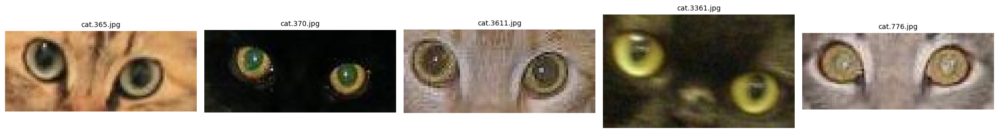

In [37]:
plot_images_from_directory('./Concepts-Revised/PositiveConcepts/PositiveRoundEyes')


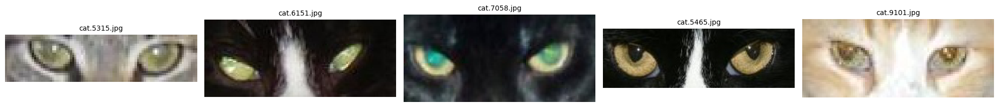

In [38]:
plot_images_from_directory('./Concepts-Revised/NegativeConcepts/NegativeRoundEyes')

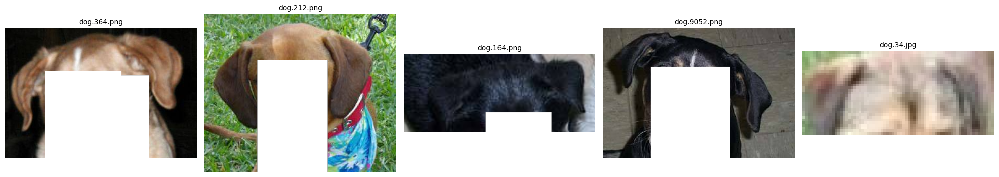

In [40]:
plot_images_from_directory('./Concepts-Revised/PositiveConcepts/PositiveFloppyEars')

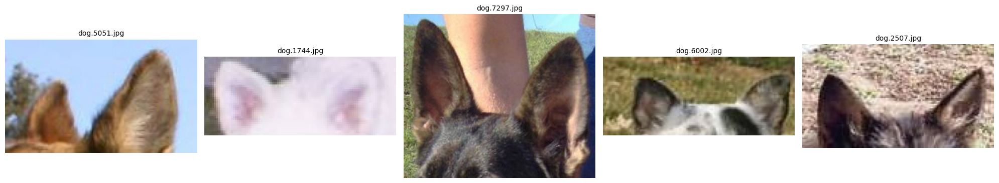

In [41]:
plot_images_from_directory('./Concepts-Revised/NegativeConcepts/NegativeFloppyEars')

In [ ]:
os.makedirs('./activations-revised', exist_ok=True)
os.makedirs('./cavs-revised', exist_ok=True)


data_transforms = transforms.Compose([
    transforms.Resize(224),  
    SquarePad(),            
    transforms.ToTensor(),  
    transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])  
])



concepts = ["RoundEyes", "FloppyEars"]


class SingleClassDataset(Dataset):
    def __init__(self, root_dir, transform=None):
        self.root_dir = root_dir
        self.transform = transform
        self.image_files = [f for f in os.listdir(root_dir) if f.endswith(('jpg', 'jpeg', 'png'))]

    def __len__(self):
        return len(self.image_files)

    def __getitem__(self, idx):
        img_path = os.path.join(self.root_dir, self.image_files[idx])
        image = Image.open(img_path).convert("RGB")
        
        if self.transform:
            image = self.transform(image)
        
        return image, 0



model = model.to(device)


# each directory containing the directories of xoncepts is called xoncepts_directory
# each directory that has either the positive or negative examples of a concept is called a xoncept

# for example, NegativeRoundEyes and PositiveRoundEyes are both xoncept
# for example, NegativeConcepts and PositiveConcepts are both xoncepts_directory


def xoncept_activation_generator(xoncept, xoncepts_directory, transformations, batch_size, shuffle, model, layer_of_interest, device):
    print(f"Working on xoncept {xoncept}")
    dataset = SingleClassDataset(f"{xoncepts_directory}/{xoncept}", transform= transformations)
    dataloader = DataLoader(dataset, batch_size, shuffle)
    activation_generator = ActivationGenerator(model, target_layer=layer_of_interest, device=device)
    print(f"The size of the corresponding activations is:")
    activations = activation_generator.get_activations(dataloader)
    # print(f" the mean of activations of all images: {np.mean(activation_generator.get_activations(dataloader))}")
    activation_generator.save_activations(activations, f'./activations-revised/{xoncept}.npy')
    print("\n")


for LAYER_OF_INTEREST in list_of_conv_layers[52:]:
    c = datetime.now()
    current_time = c.strftime('%H:%M:%S')
    print("***************************************")
    print(f"Working on layer {LAYER_OF_INTEREST}")
    print('Current Time is:', current_time)
    print("***************************************")


    for xoncepts_directory in ["./Concepts-Revised/PositiveConcepts", "./Concepts-Revised/NegativeConcepts"]:
        for xoncept in os.listdir(xoncepts_directory):
            xoncept_activation_generator(xoncept = xoncept, xoncepts_directory = xoncepts_directory, transformations= data_transforms,
                    batch_size=1, shuffle=False, model= model, layer_of_interest= LAYER_OF_INTEREST, device=device)
            


    for concept in concepts:
        positive_concept_activations = np.load(f"./activations-revised/Positive{concept}.npy")
        negative_concept_activations = np.load(f"./activations-revised/Negative{concept}.npy")
        cav = CAV(positive_concept_activations, negative_concept_activations, concept_name = concept,
                model_layer=LAYER_OF_INTEREST, save_path='./cavs-revised')
        cav.train_cav()



    test_dataset = datasets.ImageFolder(root="./dog-cat-full-dataset-master/data/test", transform=data_transforms)
    test_loader = DataLoader(test_dataset, batch_size=1, shuffle=False)



    for concept in concepts:
        cav_path = "./cavs-revised"
        for class_index, class_name in enumerate(test_dataset.classes):
            tcav = TCAV(model=model, cav_path=cav_path, concept_name= concept, test_loader=test_loader,
                        target_layer=LAYER_OF_INTEREST, model_layer = LAYER_OF_INTEREST, target_class=class_index, device=device, )
            
            tcav_score = tcav.compute_tcav_score()
            print(f"TCAV score for concept '{concept}' and class '{class_name}' is: {tcav_score}")



***************************************
Working on layer module.inception5b.branch2.0.conv
Current Time is: 15:19:28
***************************************
Working on xoncept PositiveFloppyEars
The size of the corresponding activations is:
(50, 192, 7, 7)
Activations saved to ./activations-revised/PositiveFloppyEars.npy




Working on xoncept NegativeFloppyEars
The size of the corresponding activations is:
(50, 192, 7, 7)
Activations saved to ./activations-revised/NegativeFloppyEars.npy






TCAV score for concept 'FloppyEars' and class 'cats' is: 0.0
TCAV score for concept 'FloppyEars' and class 'dogs' is: 0.0
***************************************
Working on layer module.inception5b.branch2.1.conv
Current Time is: 15:27:03
***************************************
Working on xoncept PositiveFloppyEars
The size of the corresponding activations is:
(50, 384, 7, 7)
Activations saved to ./activations-revised/PositiveFloppyEars.npy




Working on xoncept NegativeFloppyEars
The size of the corresponding activations is:
(50, 384, 7, 7)
Activations saved to ./activations-revised/NegativeFloppyEars.npy




TCAV score for concept 'FloppyEars' and class 'cats' is: 1.0
TCAV score for concept 'FloppyEars' and class 'dogs' is: 1.0
***************************************
Working on layer module.inception5b.branch3.0.conv
Current Time is: 15:36:29
***************************************
Working on xoncept PositiveFloppyEars
The size of the corresponding activations is:
(50, 48, 7, 7)
Act

KeyboardInterrupt: 

TCAV score for concept 'RoundEyes' and class 'cats' is: 1.0  
TCAV score for concept 'RoundEyes' and class 'dogs' is: 1.0  
TCAV score for concept 'FloppyEars' and class 'cats' is: 0.0  
TCAV score for concept 'FloppyEars' and class 'dogs' is: 0.0  
***************************************
Working on layer module.inception5b.branch2.1.conv
Current Time is: 17:21:56
***************************************
Working on xoncept PositiveRoundEyes
The size of the corresponding activations is:
(50, 384, 7, 7)
Activations saved to ./activations-revised/PositiveRoundEyes.npy




Working on xoncept PositiveFloppyEars
The size of the corresponding activations is:
(50, 384, 7, 7)
Activations saved to ./activations-revised/PositiveFloppyEars.npy




Working on xoncept NegativeRoundEyes
The size of the corresponding activations is:
(50, 384, 7, 7)
Activations saved to ./activations-revised/NegativeRoundEyes.npy




Working on xoncept NegativeFloppyEars
The size of the corresponding activations is:
(50, 384, 7, 7)
Activations saved to ./activations-revised/NegativeFloppyEars.npy




TCAV score for concept 'RoundEyes' and class 'cats' is: 0.0
TCAV score for concept 'RoundEyes' and class 'dogs' is: 0.0
TCAV score for concept 'FloppyEars' and class 'cats' is: 1.0
TCAV score for concept 'FloppyEars' and class 'dogs' is: 1.0
***************************************
Working on layer module.inception5b.branch3.0.conv
Current Time is: 17:50:08
***************************************
Working on xoncept PositiveRoundEyes
The size of the corresponding activations is:
(50, 48, 7, 7)
Activations saved to ./activations-revised/PositiveRoundEyes.npy




Working on xoncept PositiveFloppyEars
The size of the corresponding activations is:
(50, 48, 7, 7)
Activations saved to ./activations-revised/PositiveFloppyEars.npy




Working on xoncept NegativeRoundEyes
The size of the corresponding activations is:
(50, 48, 7, 7)
Activations saved to ./activations-revised/NegativeRoundEyes.npy




Working on xoncept NegativeFloppyEars
The size of the corresponding activations is:
(50, 48, 7, 7)
Activations saved to ./activations-revised/NegativeFloppyEars.npy




TCAV score for concept 'RoundEyes' and class 'cats' is: 1.0  
TCAV score for concept 'RoundEyes' and class 'dogs' is: 1.0  
TCAV score for concept 'FloppyEars' and class 'cats' is: 0.0  
TCAV score for concept 'FloppyEars' and class 'dogs' is: 0.0  
***************************************
Working on layer module.inception5b.branch3.1.conv
Current Time is: 18:27:35
***************************************
Working on xoncept PositiveRoundEyes
The size of the corresponding activations is:
(50, 128, 7, 7)
Activations saved to ./activations-revised/PositiveRoundEyes.npy




Working on xoncept PositiveFloppyEars
The size of the corresponding activations is:
(50, 128, 7, 7)
Activations saved to ./activations-revised/PositiveFloppyEars.npy




Working on xoncept NegativeRoundEyes
The size of the corresponding activations is:
(50, 128, 7, 7)
Activations saved to ./activations-revised/NegativeRoundEyes.npy




Working on xoncept NegativeFloppyEars
The size of the corresponding activations is:
(50, 128, 7, 7)
Activations saved to ./activations-revised/NegativeFloppyEars.npy




TCAV score for concept 'RoundEyes' and class 'cats' is: 0.0
TCAV score for concept 'RoundEyes' and class 'dogs' is: 0.0
TCAV score for concept 'FloppyEars' and class 'cats' is: 1.0
TCAV score for concept 'FloppyEars' and class 'dogs' is: 1.0
***************************************
Working on layer module.inception5b.branch4.1.conv
Current Time is: 19:15:51
***************************************
Working on xoncept PositiveRoundEyes
The size of the corresponding activations is:
(50, 128, 7, 7)
Activations saved to ./activations-revised/PositiveRoundEyes.npy




Working on xoncept PositiveFloppyEars
The size of the corresponding activations is:
(50, 128, 7, 7)
Activations saved to ./activations-revised/PositiveFloppyEars.npy




Working on xoncept NegativeRoundEyes
The size of the corresponding activations is:
(50, 128, 7, 7)
Activations saved to ./activations-revised/NegativeRoundEyes.npy




Working on xoncept NegativeFloppyEars
The size of the corresponding activations is:
(50, 128, 7, 7)
Activations saved to ./activations-revised/NegativeFloppyEars.npy




TCAV score for concept 'RoundEyes' and class 'cats' is: 0.0
TCAV score for concept 'RoundEyes' and class 'dogs' is: 0.0
TCAV score for concept 'FloppyEars' and class 'cats' is: 0.0
TCAV score for concept 'FloppyEars' and class 'dogs' is: 0.0


After refining my concepts to include only the regions specifically related to "RoundEyes" and "FloppyEars," the TCAV scores showed significant changes. 


For some layers, the concepts became highly influential, while for others, their impact remained negligible.

In layers like module.inception5b.branch2.1.conv and module.inception5b.branch3.0.conv, the concept of "RoundEyes" achieved a TCAV score of 1.0 for both cats and dogs, indicating that this concept strongly influenced the model’s predictions in these layers. Similarly, in layers like module.inception5b.branch3.1.conv, the "FloppyEars" concept became dominant with a score of 1.0 for both classes. These results suggest that the model heavily relies on these specific concepts in certain layers to make classification decisions.

Interestingly, the influence of each concept was not consistent across all layers. In some cases, such as module.inception5b.branch4.1.conv, both concepts had TCAV scores of 0.0, showing no impact on the model’s predictions. This indicates that the relevance of concepts is layer-dependent, with some layers encoding certain features more prominently than others.

These refined results confirm that the model does encode human-interpretable concepts like "RoundEyes" and "FloppyEars," but the importance of these concepts varies by layer. This layer-specific behavior show the hierarchical nature of CNNs, where different layers capture different levels of abstraction. 

## Conclusions

In this project, I delved into understanding the inner workings of Convolutional Neural Networks (CNNs) using several interpretability techniques, including feature maps, saliency maps, and TCAV.  
Through these experiments, I learned a great deal about how CNNs process images and make decisions, as well as the challenges of making these processes interpretable for humans.

The primary takeaway from this project was how CNNs extract and process features in a hierarchical manner. 

By visualizing feature maps, I observed that earlier layers focused on low-level features like edges and textures, while deeper layers captured more abstract patterns such as shapes or complex textures. This progression aligns with human intuition about how vision systems work, starting with simple details and integrating them into higher-level abstractions.   
However, one challenge here was interpreting feature maps in the deeper layers while they undoubtedly encode critical features, they become increasingly abstract and harder to directly correlate with human-understandable concepts.

Saliency maps were another significant component of the project. These maps provided insights into the specific regions of the input images that influenced the model's predictions the most. By generating saliency maps for both training and unseen images, I saw how the model often focused on key regions like the head or body of animals. Interestingly, the saliency maps were intuitive and frequently aligned with human expectations, such as focusing on a cat’s head or a dog’s floppy ears. However, the most difficult part was handling the sensitivity of saliency maps to noise or small input variations, which sometimes made them unstable or hard to generalize.

The TCAV (Testing with Concept Activation Vectors) analysis was one of the most enlightening yet challenging parts of the project. TCAV allowed me to quantify how human-interpretable concepts like "RoundEyes" or "FloppyEars" influenced the model's decisions. Initially, the results were surprising—when I used the unfiltered dataset, the TCAV scores were consistently 0, suggesting that these concepts had no measurable impact on the model’s predictions. This was unexpected and pushed me to revise my approach. By carefully cleaning the dataset to include only the relevant regions of the concepts and excluding irrelevant portions, I observed dramatic improvements in TCAV scores. 

The refined scores revealed that certain concepts were highly influential in specific layers, confirming that CNNs encode human-interpretable concepts but that these are encoded in a layer-specific manner.

The most difficult aspect of TCAV was ensuring that the positive and negative examples of concepts were well-defined and distinct enough to produce meaningful Concept Activation Vectors. Preparing and filtering the dataset for these concepts was time-intensive but necessary for the method to work effectively. This process highlighted the importance of data preprocessing.

A significant surprise I encountered was how layer-dependent the encoding of features and concepts was. Some layers strongly captured specific concepts, as shown by high TCAV scores, while other layers seemed to completely disregard them. This layer-specific behavior reinforced the idea that CNNs operate hierarchically, and interpretability techniques must be applied carefully to the right layers to yield meaningful insights.

### Summary

In summary, this project taught me that while CNNs are strong tools for image classification, understanding their decision-making process requires a combination of visualization techniques and careful experimentation. The most difficult parts were ensuring the stability and reliability of these methods and cleaning the datasets for meaningful results. The most surprising takeaway was how specific layers encode human-interpretable features, revealing a structured and logical organization within the seemingly blackbox nature of CNNs. This deeper understanding has strengthened my appreciation for the power and complexity of neural networks.

# References

* [Krizhevsky et al., 2012] Krizhevsky, Alex, Ilya Sutskever, and Geoffrey E. Hinton. "ImageNet classification with deep convolutional neural networks." Advances in neural information processing systems. 2012.
* [Will Cukierski, 2013] Dogs vs. Cats, [Kaggle](https://kaggle.com/competitions/dogs-vs-cats), Kaggle, 2013.
* [Azam et al., 2023] Azam, Sami, Sidratul Montaha, Kayes Uddin Fahim, A.K.M. Rakibul Haque Rafid, Md. Saddam Hossain Mukta, and Mirjam Jonkman. "Using feature maps to unpack the CNN 'Black box' theory with two medical datasets of different modality." Intelligent Systems with Applications 18 (2023)
* [Simonyan et al., 2013] Simonyan, K., Vedaldi, A., and Zisserman, A. "Deep Inside Convolutional Networks: Visualising Image Classification Models and Saliency Maps." arXiv preprint arXiv:1312.6034, 2013.
* [Kim et al., 2018] Kim, Been, Martin Wattenberg, and J. Hindy Zehnder. "Interpretability Beyond Feature Attribution: Quantitative Testing with Concept Activation Vectors (TCAV)." arXiv preprint arXiv:1711.11279, 2018.



In [1]:
import io
import nbformat
import glob
nbfile = glob.glob('Project Report.ipynb')
if len(nbfile) > 1:
    print('More than one ipynb file. Using the first one.  nbfile=', nbfile)
with io.open(nbfile[0], 'r', encoding='utf-8') as f:
    nb = nbformat.read(f, nbformat.NO_CONVERT)
word_count = 0
for cell in nb.cells:
    if cell.cell_type == "markdown":
        word_count += len(cell['source'].replace('#', '').lstrip().split(' '))
print('Word count for file', nbfile[0], 'is', word_count)

Word count for file Project Report.ipynb is 7738
